In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
# import os

# import cv2
# import skimage
# import IPython.display
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from PIL import Image
import numpy as np
from glob import glob

# from collections import OrderedDict
# import torch
# import gc

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [1]:
!pip freeze > requirements.txt

# Install CLIP library

In [ ]:
pip install requirements.txt
pip install ./openaiclipweights/python-ftfy-master/python-ftfy-master
pip install ./openaiclipweights/clip/CLIP
cp ./openaiclipweights/CLIP-main/CLIP-main/clip/bpe_simple_vocab_16e6.txt ../.venv/Lib/site-packages/clip/.
gzip -k ../.venv/Lib/site-packages/clip/bpe_simple_vocab_16e6.txt
ls ../.venv/Lib/site-packages/clip/bpe_simple_vocab_16e6.txt

SyntaxError: invalid syntax (3345660298.py, line 1)

In [5]:
import torch
import clip
from tqdm.notebook import tqdm
from torch.utils.data import DataLoader, Dataset

print("Torch version:", torch.__version__)

FileNotFoundError: [Errno 2] No such file or directory: 'c:\\Users\\bryan\\AppData\\Local\\Programs\\Python\\Python311\\Lib\\site-packages\\clip\\bpe_simple_vocab_16e6.txt.gz'

# Download some images from open images collection.

In [11]:
import wget

# List of URLs to download
urls = [
    "https://farm8.staticflickr.com/6036/6426668771_b5b915e46c_o.jpg",
    "https://c6.staticflickr.com/8/7457/10806045045_02d3dbdcee_o.jpg",
    "https://c1.staticflickr.com/4/3267/2888764405_0a0a608604_o.jpg",
    "https://farm8.staticflickr.com/4028/4294212194_a49663b2b9_o.jpg",
    "https://c5.staticflickr.com/9/8173/8019508216_6540c8686a_o.jpg",
    "https://farm3.staticflickr.com/1146/1357102390_943c5cb999_o.jpg"
]

# Loop through the URLs and download each file
for url in urls:
    wget.download(url)


In [3]:
files = glob('*.jpeg')
files += glob('*.jpg')
print(files)

['213452132-8976.jpg', '234567890-3423.jpg', '24359056-1245.jpg', '24567890_235.jpg', '2b9c96e2a7ca039999d255d6445ef217.jpg', '32472210918_619479f303_b.jpg', '49592284938270.jpg', '812VfL2IhbL.jpg', 'def5dffcbde18124e4646af140664715.jpg', 'images.jpg', 'nostalgic-1960-japan-scene-toy-cars-tokyo-tower-autumn-vibes-retro-style-childhood-speed_950002-152704.jpg', 's-l1200.jpg', 's-l1600.jpg']


# List pretrained CLIP models available

In [4]:
clip.available_models()

['RN50', 'RN101', 'RN50x4', 'RN50x16', 'ViT-B/32', 'ViT-B/16']

# List pretrained weights available

In [5]:
!ls ./openaiclipweights/clip/CLIP/models/

'ls' is not recognized as an internal or external command,
operable program or batch file.


# Vit-B-32
- Architecture: Vision Transformer (ViT)
- Type: Transformer-based model
- Patch Size: 32x32 pixels
- Transformer architecture typically found in natural language processing. In ViT, images are divided into fixed-size patches (32x32 pixels in this case), and each patch is treated as a token similar to words in NLP models. This model is powerful for capturing global context and relationships within an image but may require more data to train effectively.

In [5]:
model, preprocess = clip.load("./openaiclipweights/clip/CLIP/models/ViT-B-32.pt")
model.cpu().eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [25]:
preprocess

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=True)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x00000259659DE8E0>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

### For each image we will query for the following sentences and see what CLIP predicts. 
- Add custom sentences here.

In [10]:
# QUERIES = [
#     "a dog",
#     "a cat",
#     "a elephant",
#     "a zebra",
#     "a sleeping dog",
#     "a sleeping cat",
#     "a giraffe",
#     "a poodle",
#     "animal inside a car",
#     "animal outside a car",
#     "a sofa",
#     "some animals",
#     "santa claus",
#     "ipod",
#     "two mugs",
#     "three mugs",
#     "blue sky",
#     "brain_scan",
#     "brain",
#     "human",
#     "baldur's gate",
#     "knight",
#     "blue hair",
#     "game"
# ]
QUERIES = [
    "A red toy car",
    "A blue toy car",
    "A green toy car",
    "A yellow toy car",
    "A pink toy car",
    "A black toy car",
    "A white toy car",
    "A silver toy car",
    "A toy car with racing stripes",
    "A toy car with big wheels",
    "A vintage toy car",
    "A toy car collection",
    "A toy car in a box",
    "A toy car with a driver inside",
    "A toy car with many passengers inside",
    "A toy car with an open roof",
    "A toy car and a toy truck",
    "A toy car on top of a toy truck",
    "A GTR toy car",
    "A Mazda toy car",
    "A Bugatti toy car",
    "Barbie toy car",
    "Two toy cars",
    "Four toy cars",
    "Eight toy cars",
    "A toy car in the UK",
    "A toy car moving in a city"
]

### Score images vs queries using clip model

C:\Users\bryan\AppData\Local\Temp\ipykernel_22256\293172338.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


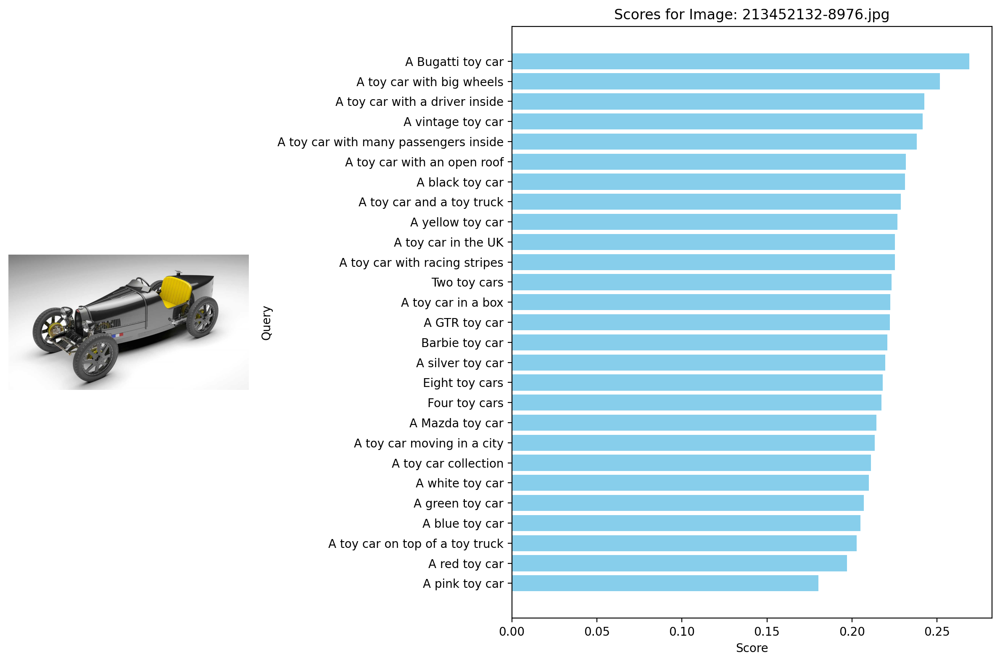

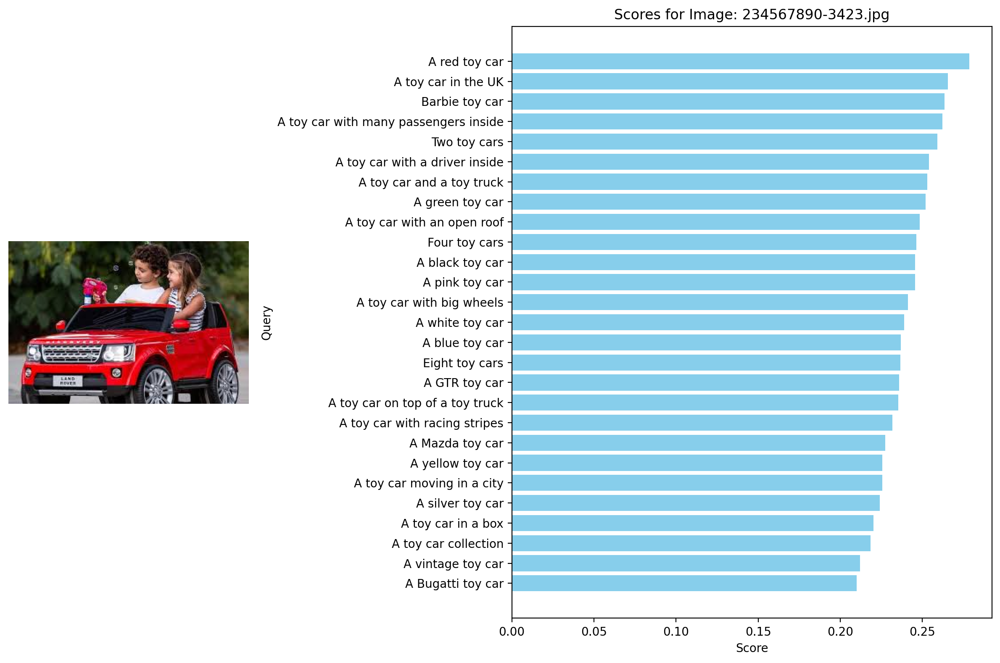

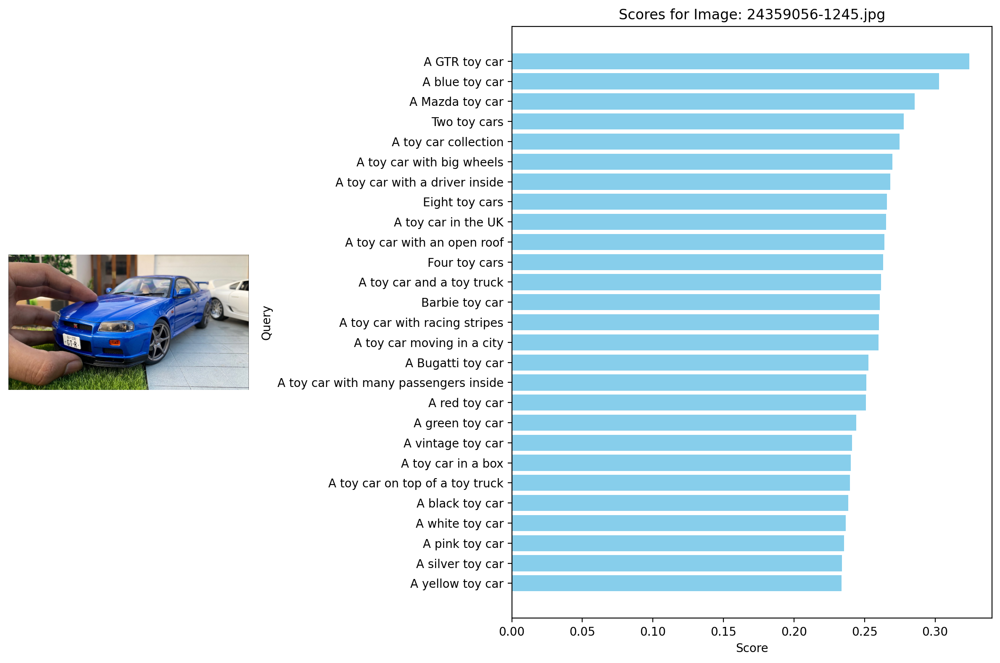

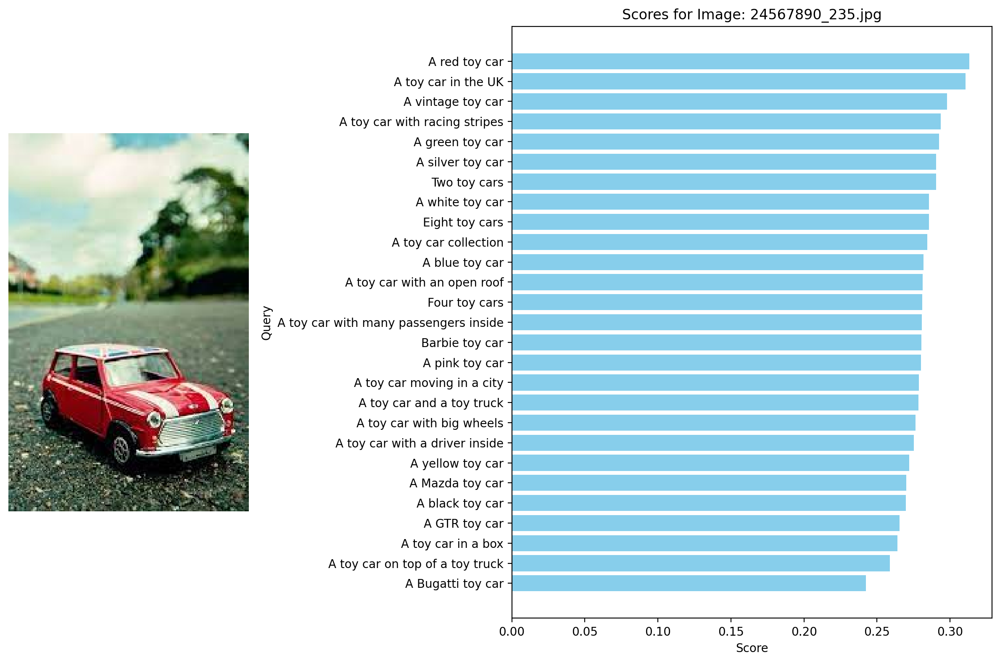

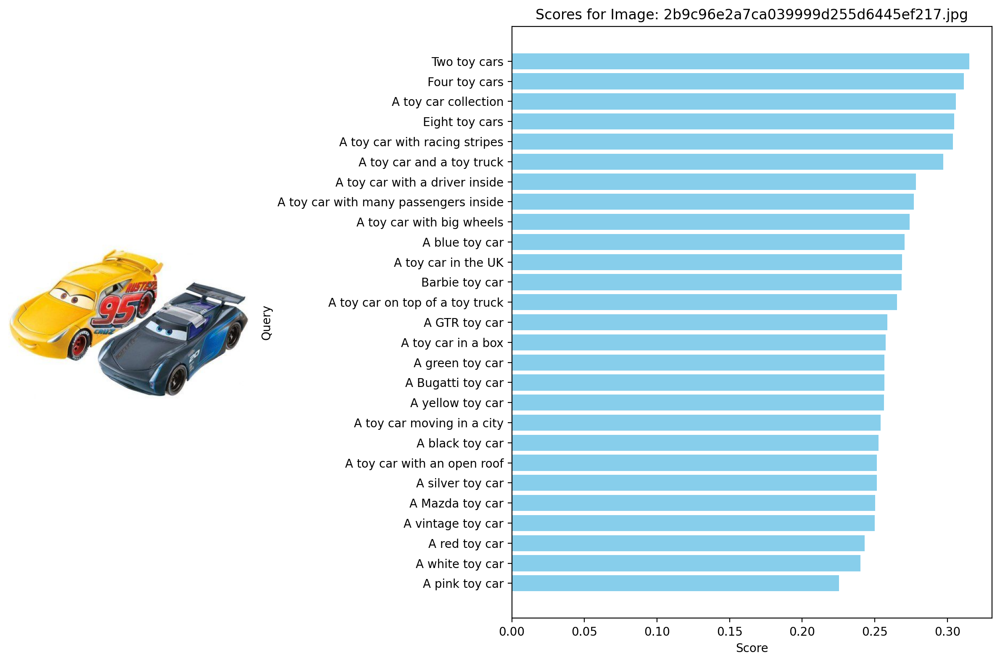

...

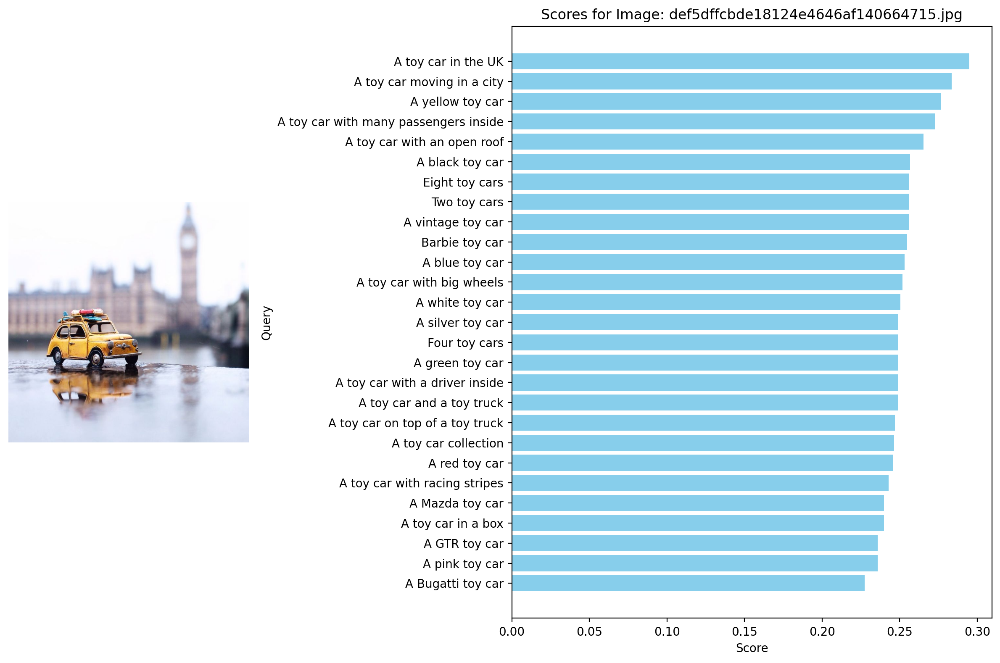

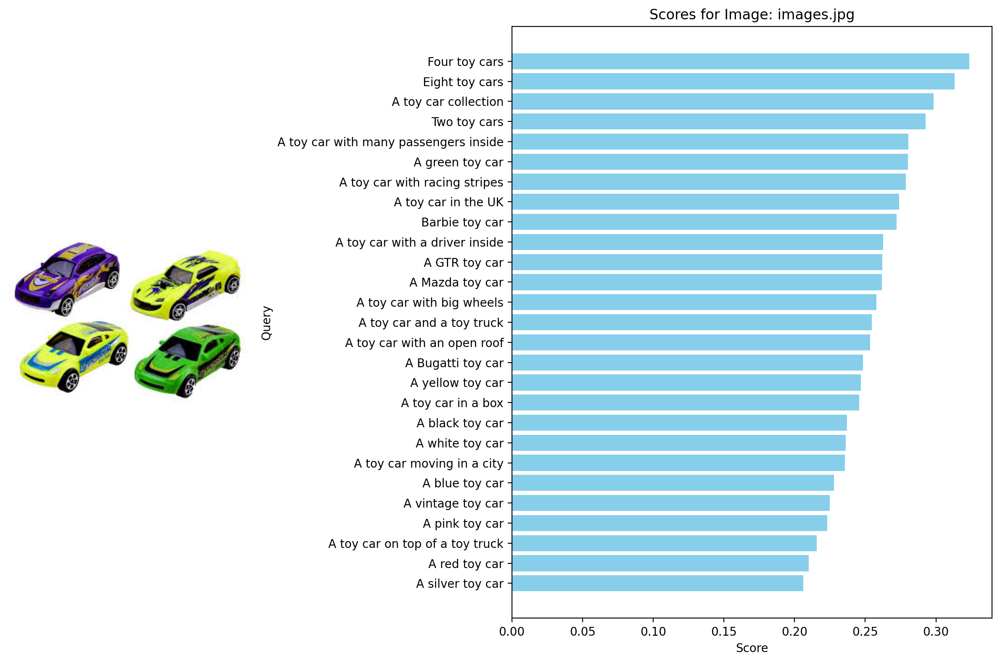

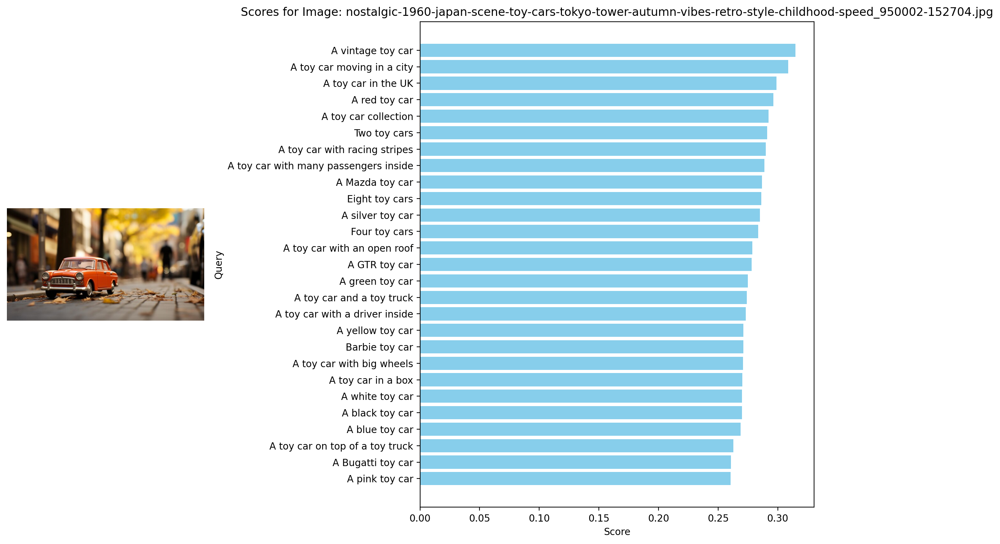

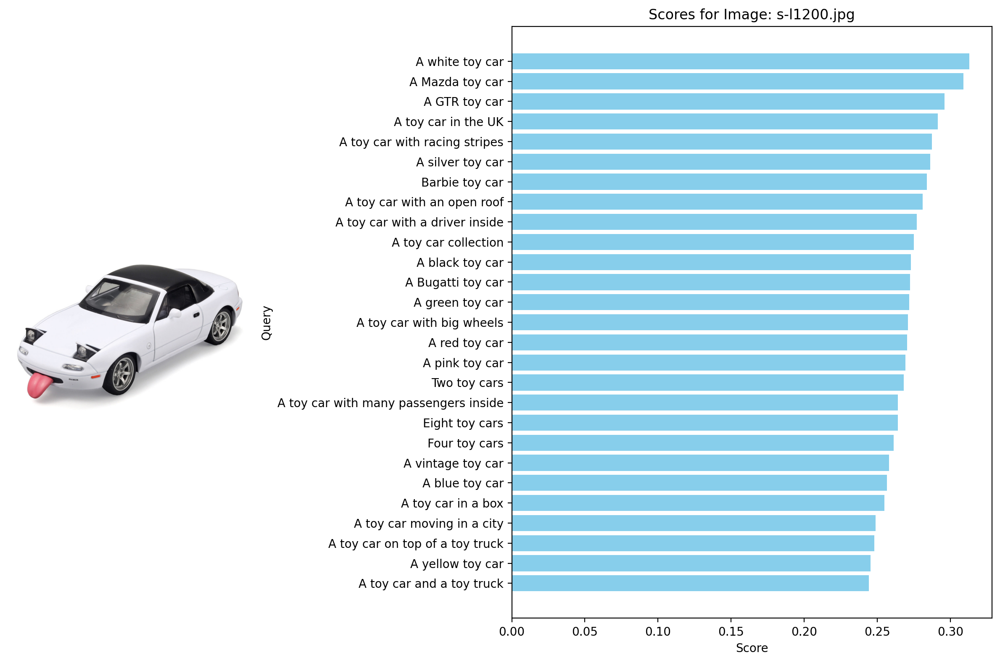

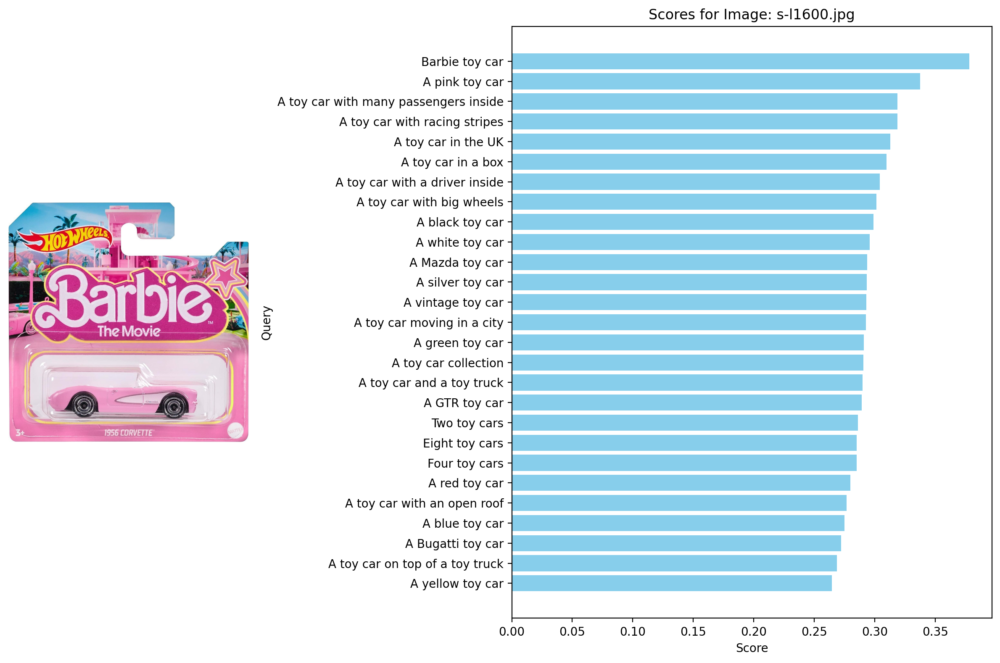

In [11]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()

In [9]:
# original_images = []
# images = []
# texts = []
# plt.figure(figsize=(16, 5))

# for filename in [filename for filename in files if filename.endswith(".png") or filename.endswith(".jpg") or filename.endswith(".jpeg")]:
#     print(filename)

# for filename in [filename for filename in files if filename.endswith(".png") or filename.endswith(".jpg") or filename.endswith(".jpeg")]:

#     image = Image.open(filename).convert("RGB")
  
#     plt.subplot(2, 4, len(images) + 1)
#     plt.imshow(image)
#     plt.title(f"{filename}")
#     plt.xticks([])
#     plt.yticks([])

#     original_images.append(image)
#     images.append(preprocess(image))

# plt.tight_layout()
# plt.show()

# Vit-B-16
- Architecture: Vision Transformer (ViT)
- Type: Transformer-based model
- Patch Size: 16x16 pixels
- Details: Similar to ViT-B/32 but with smaller patches (16x16 pixels). This allows the model to capture finer details in images, potentially improving accuracy, especially on tasks that require understanding of small or detailed objects. However, processing smaller patches increases the computational load.

In [15]:
model_viT_16, preprocess_viT_16 = clip.load("./openaiclipweights/clip/CLIP/models/ViT-B-16.pt")
model_viT_16.cpu().eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

C:\Users\bryan\AppData\Local\Temp\ipykernel_21352\465810436.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


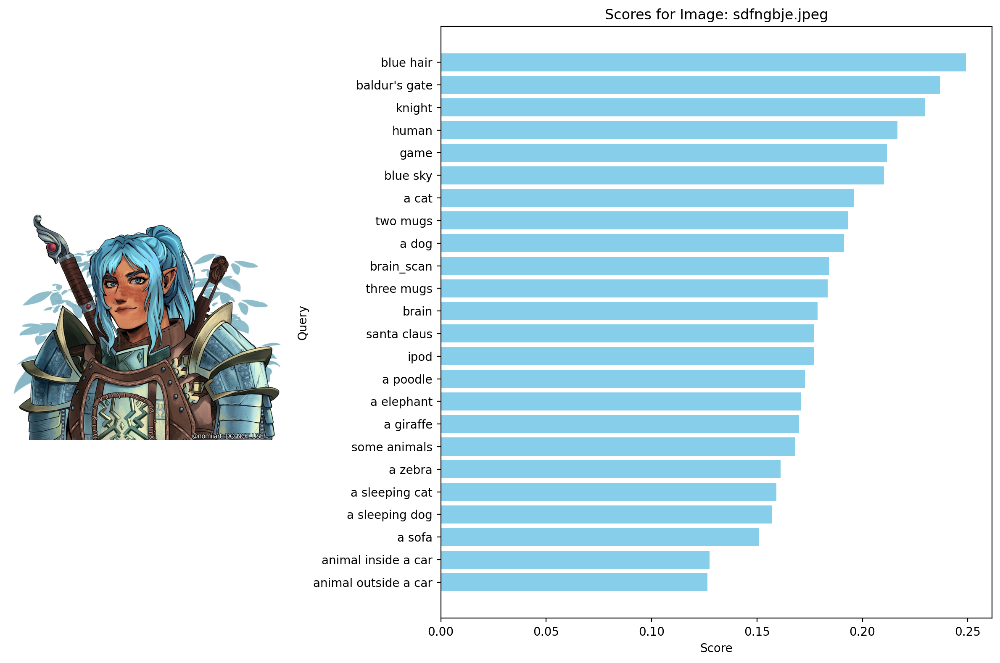

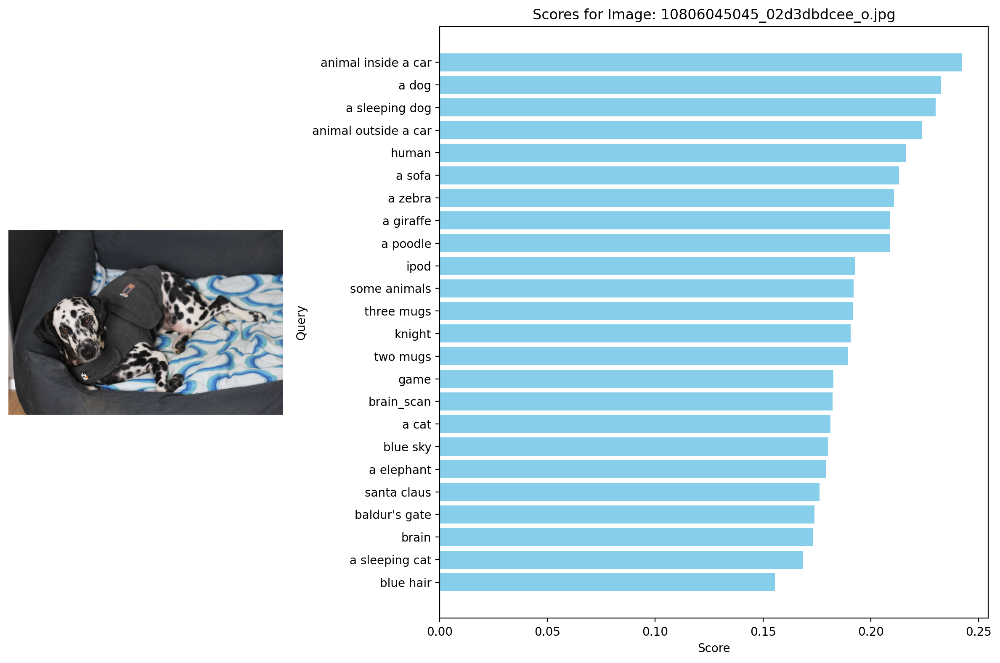

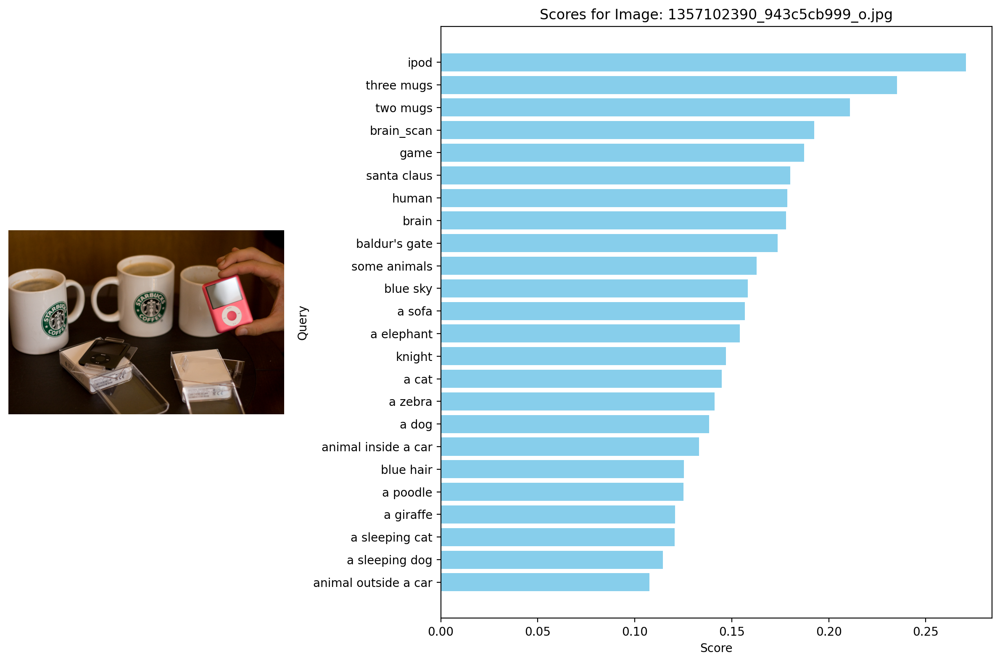

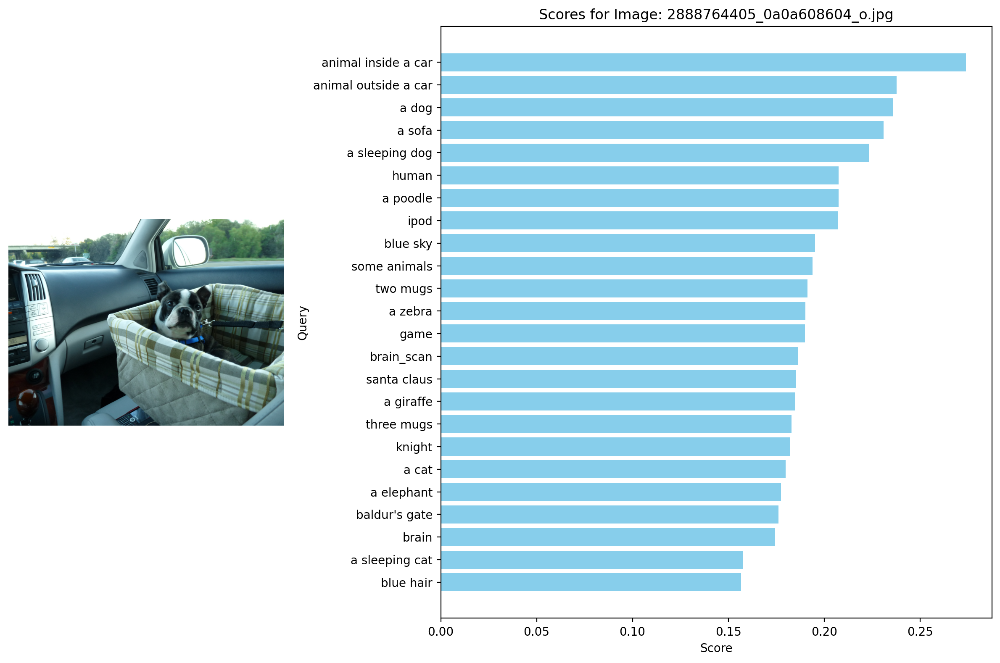

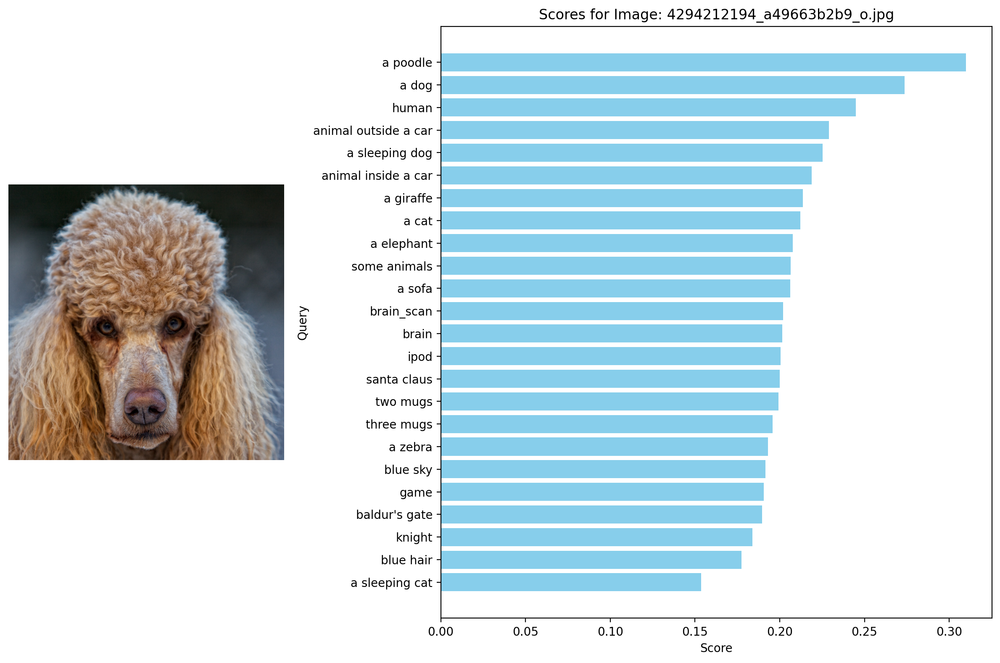

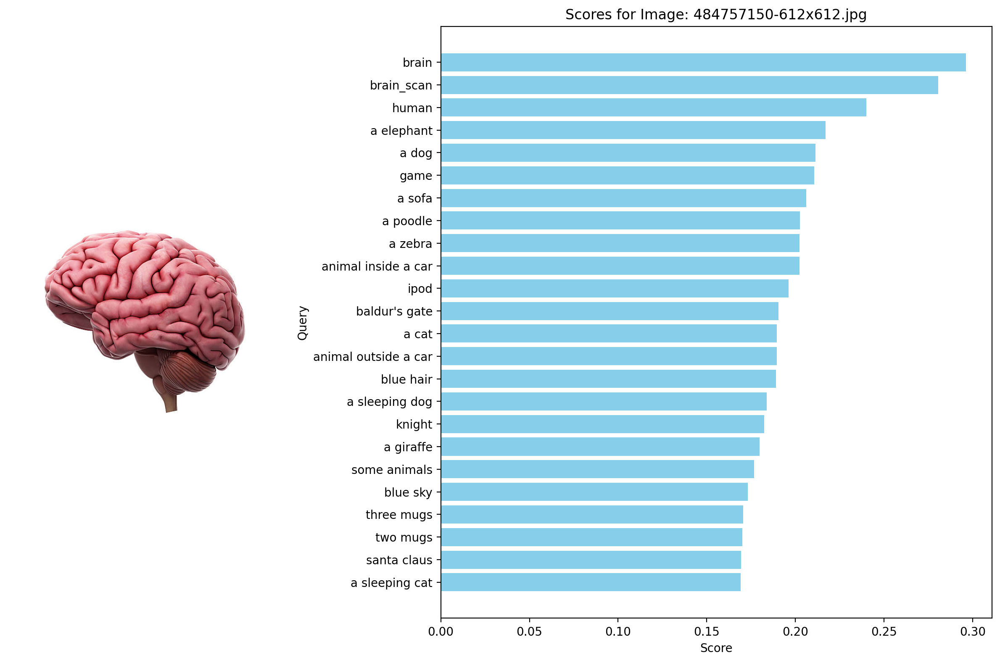

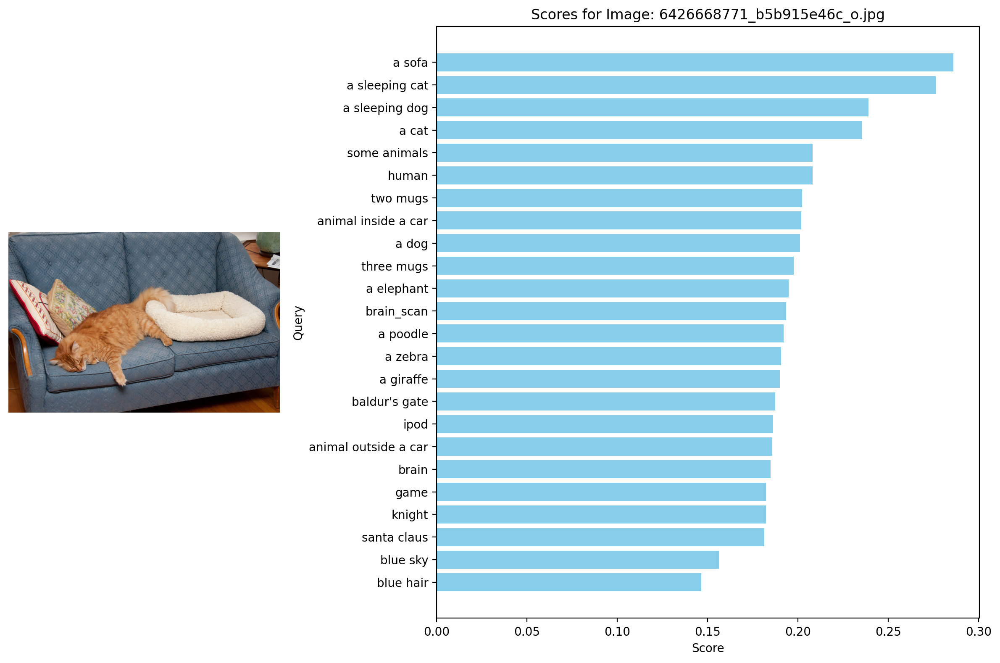

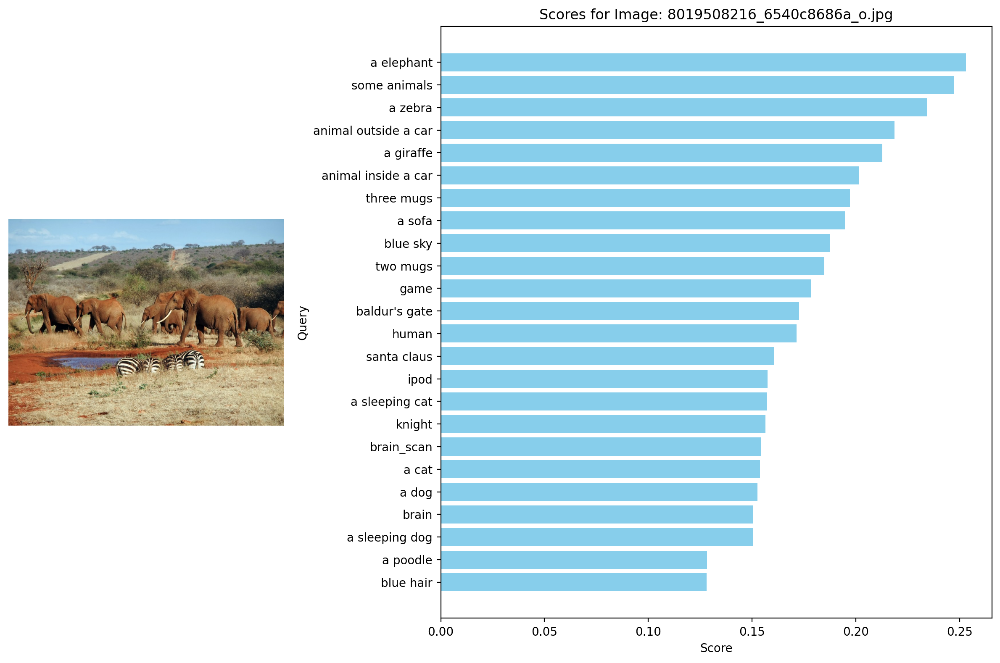

In [16]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess_viT_16(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model_viT_16.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model_viT_16.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()

# RN50x16 (ResNet-50x16)
- Architecture: ResNet-50, further scaled up
- Type: Convolutional Neural Network (CNN)
- Width Multiplier: 16
- Details: ResNet-50x16 is an even larger version of ResNet-50, with the width of the network increased by a factor of 16. This model can capture even more detailed features, offering potentially better performance for more complex tasks, but with a significant increase in computational cost and memory usage.

In [17]:
model_resnet50_16, preprocess_resnet50_16 = clip.load("./openaiclipweights/clip/CLIP/models/RN50x16.pt")
model_resnet50_16.cpu().eval()

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(48, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (relu): ReLU(inplace=True)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(96, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(96, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn

C:\Users\bryan\AppData\Local\Temp\ipykernel_21352\2828284621.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


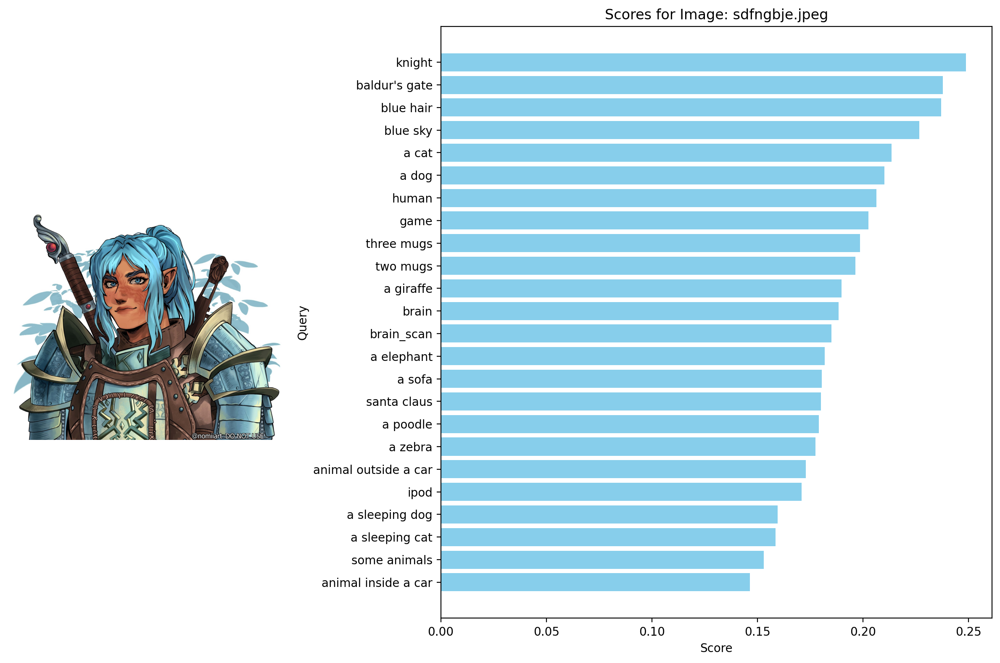

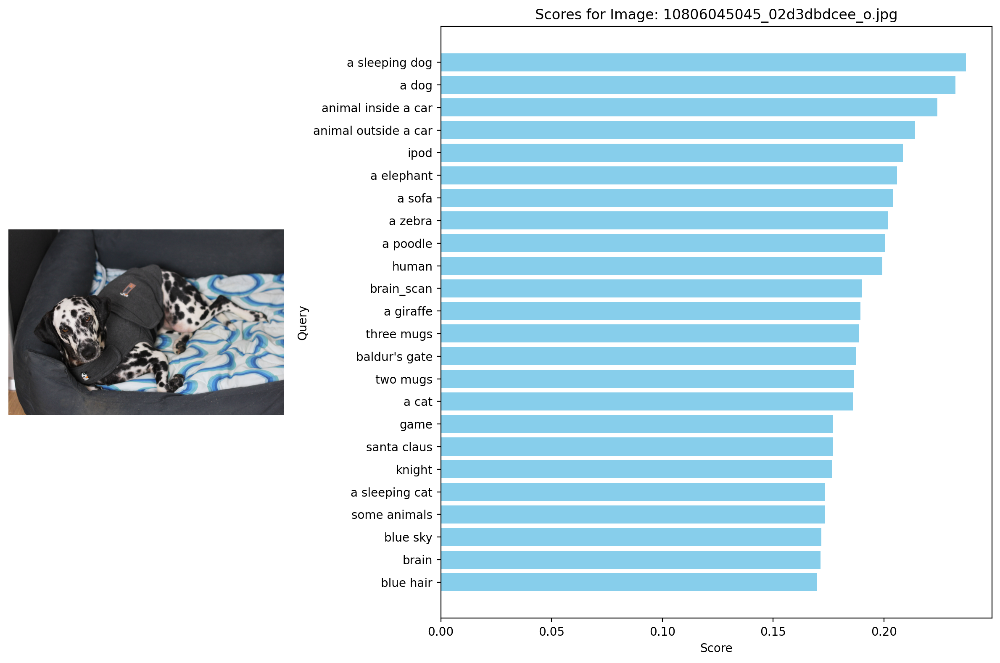

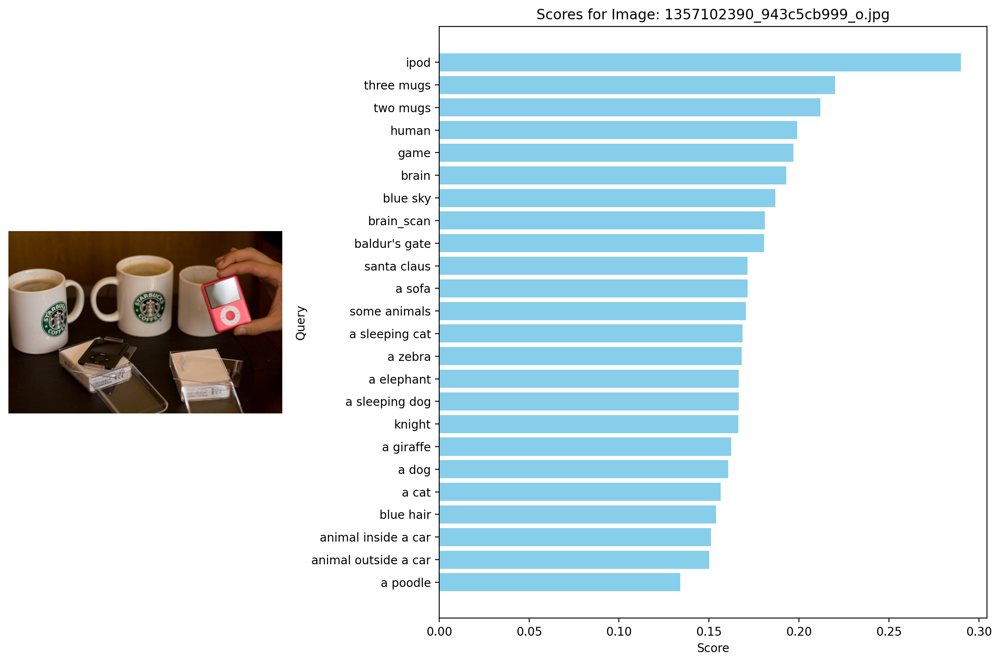

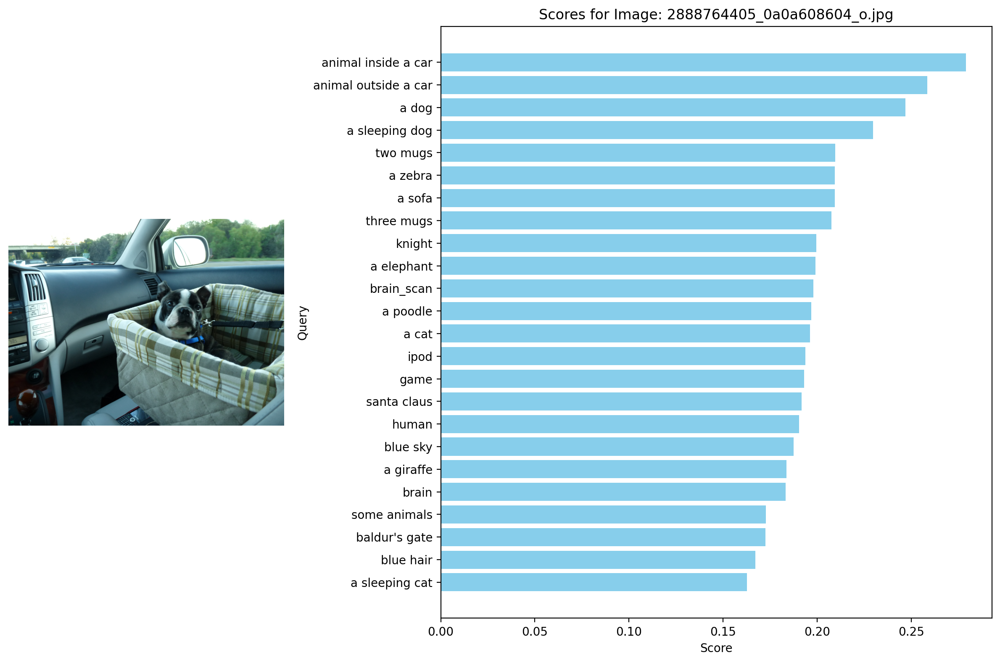

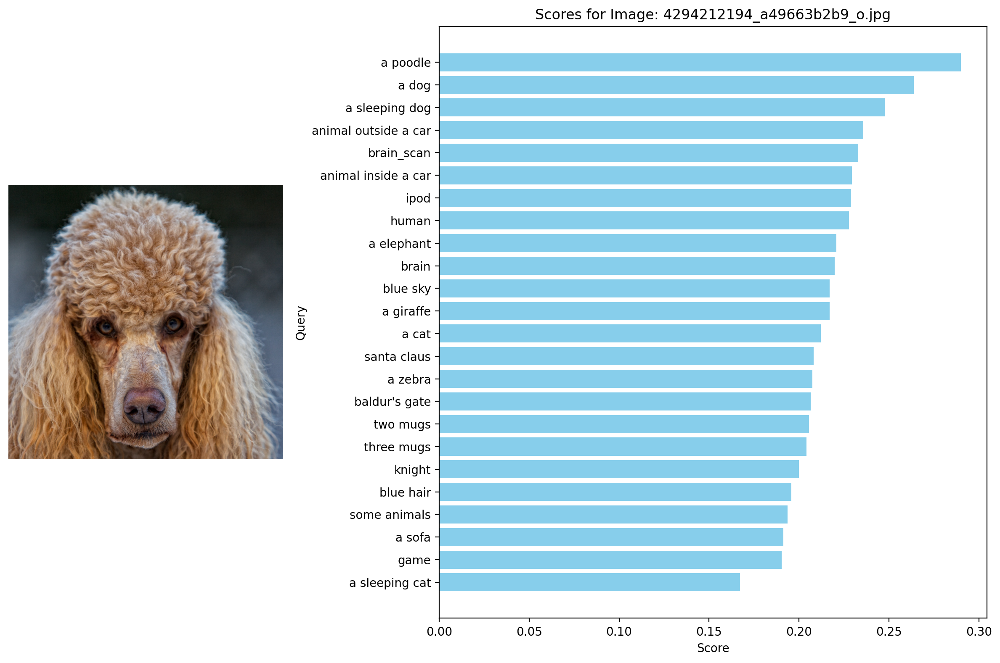

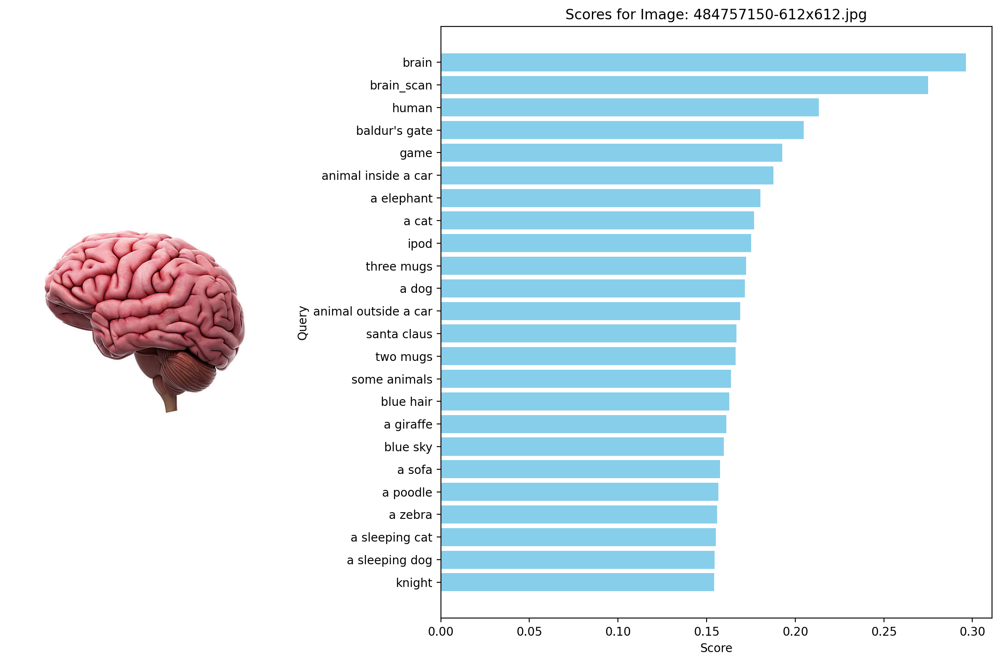

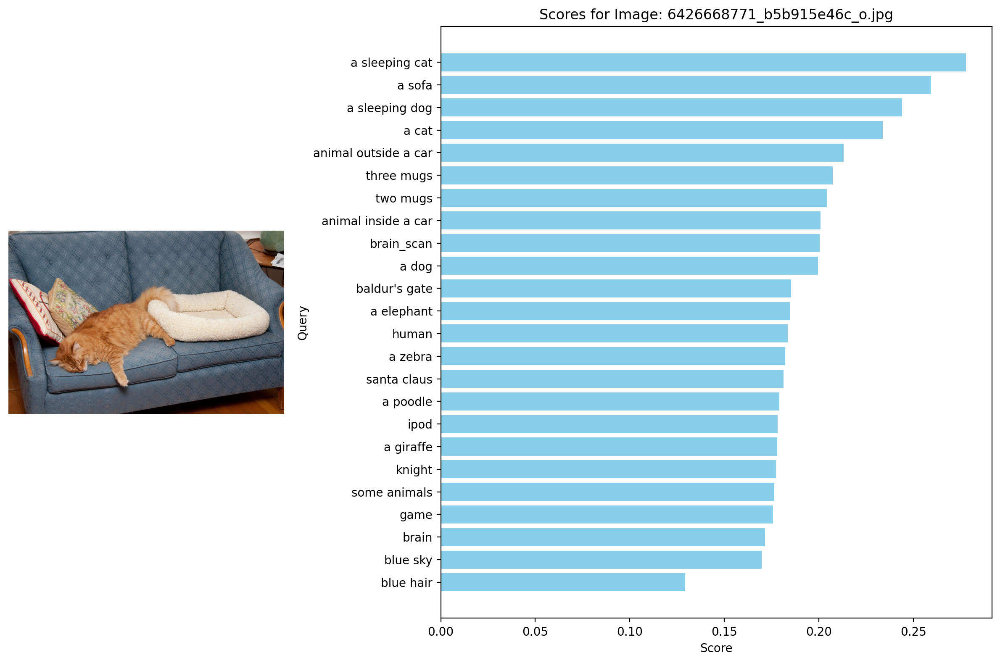

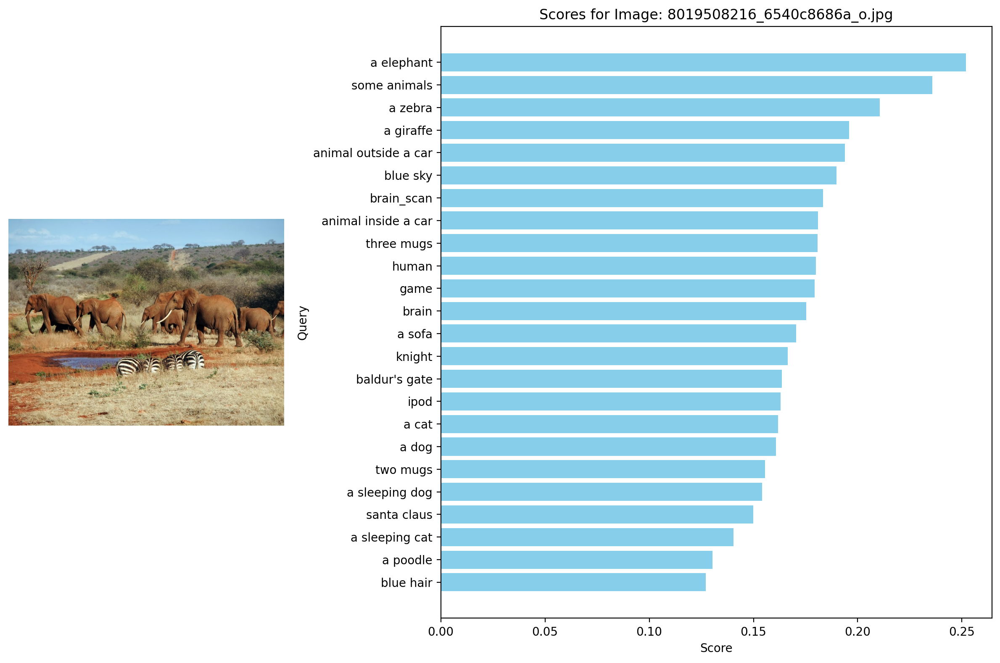

In [18]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess_resnet50_16(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model_resnet50_16.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model_resnet50_16.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()

# RN50x4 (ResNet-50x4)
- Architecture: ResNet-50, scaled up
- Type: Convolutional Neural Network (CNN)
- Width Multiplier: 4
- Details: This model is a scaled-up version of the standard ResNet-50, where the width of the network (i.e., the number of channels in each layer) is increased by a factor of 4. This results in a more powerful model with a higher capacity to learn complex patterns, but it also requires more memory and computation.

In [19]:
model_resnet50_4, preprocess_resnet50_4 = clip.load("./openaiclipweights/clip/CLIP/models/RN50x4.pt")
model_resnet50_4.cpu().eval()

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(40, 80, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (relu): ReLU(inplace=True)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(80, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(80, 80, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn

C:\Users\bryan\AppData\Local\Temp\ipykernel_21352\4035213504.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


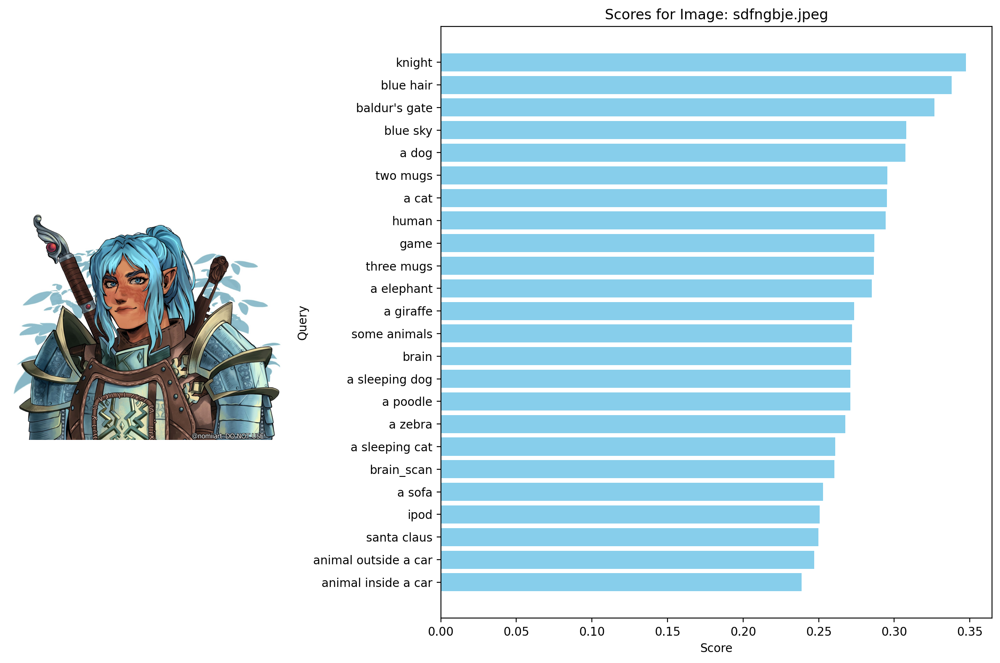

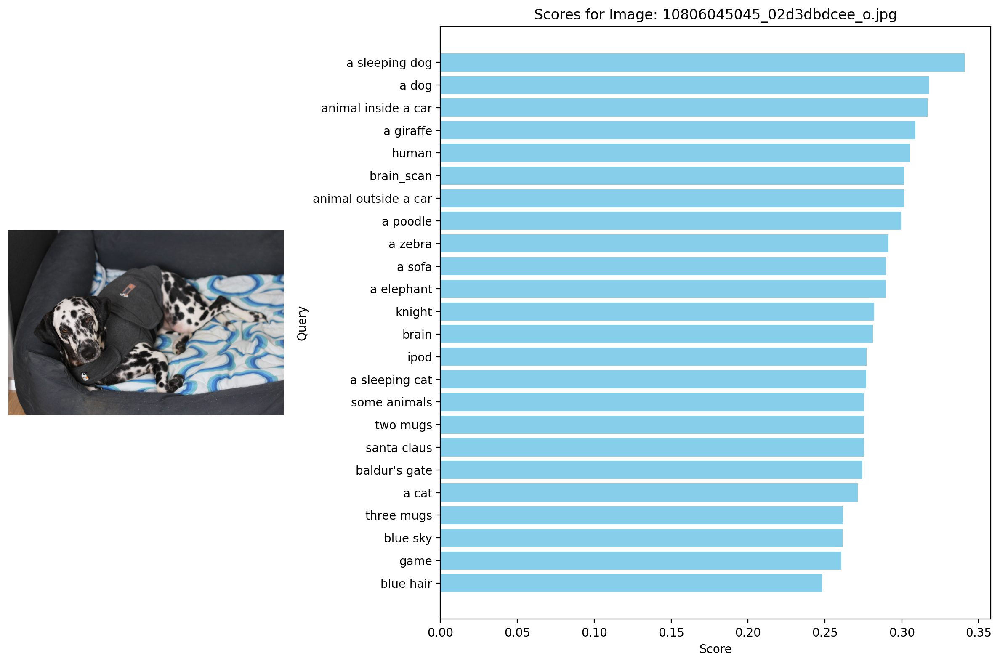

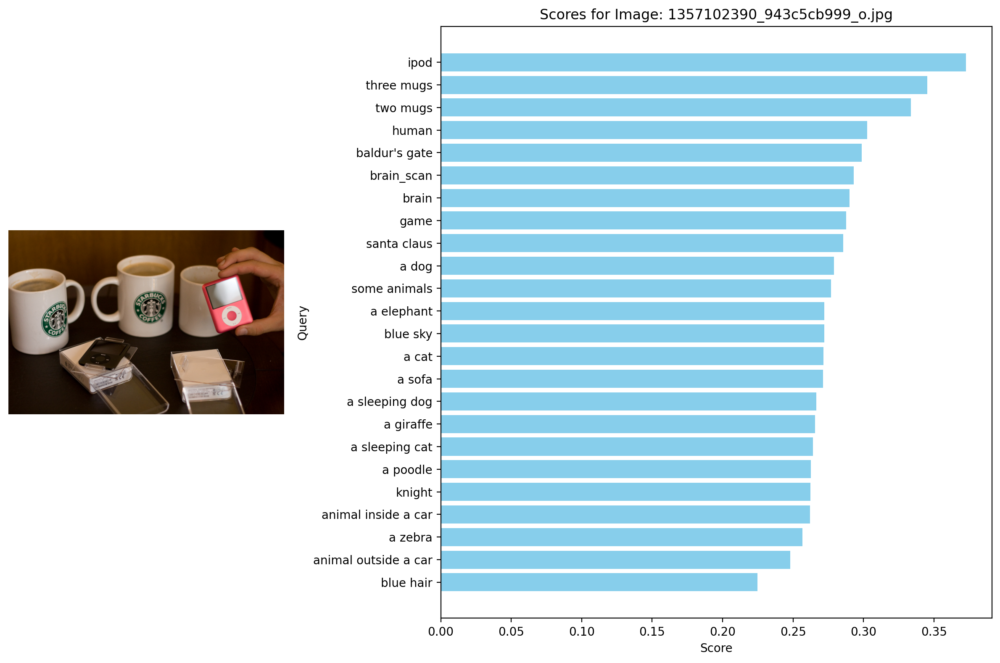

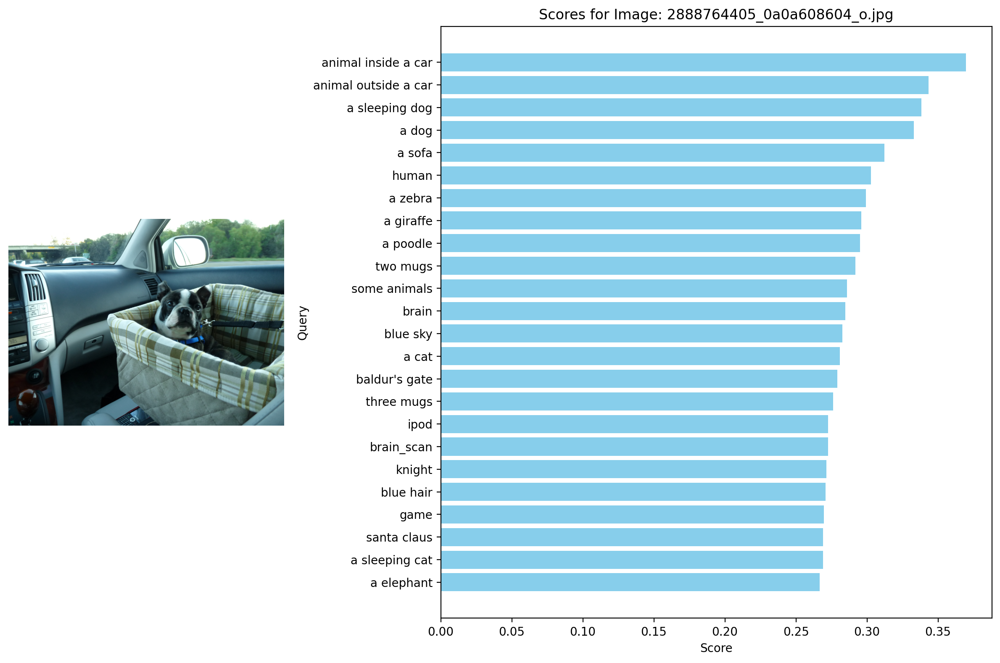

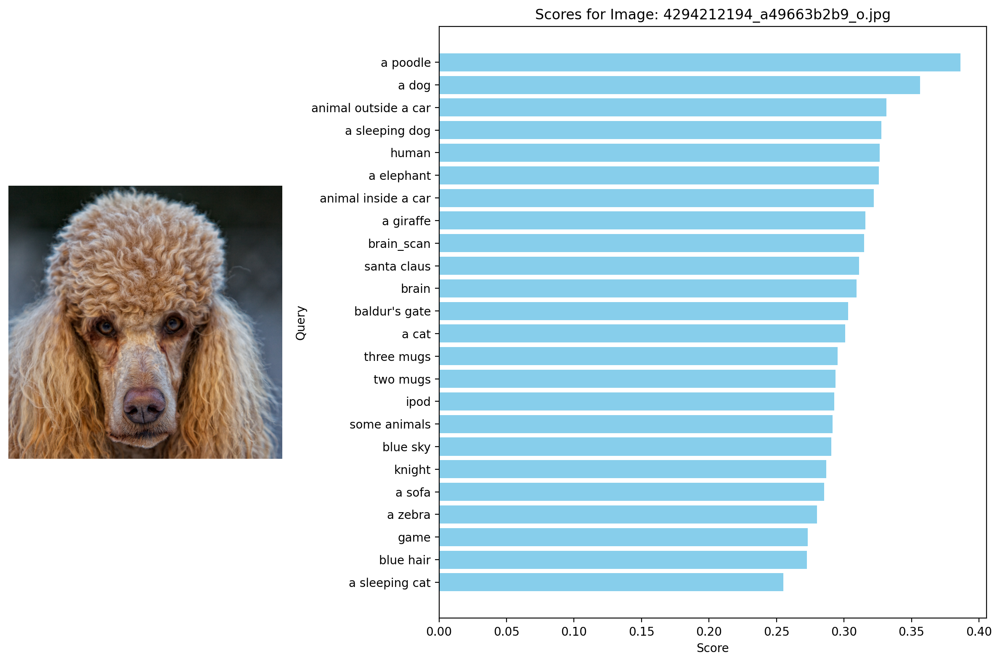

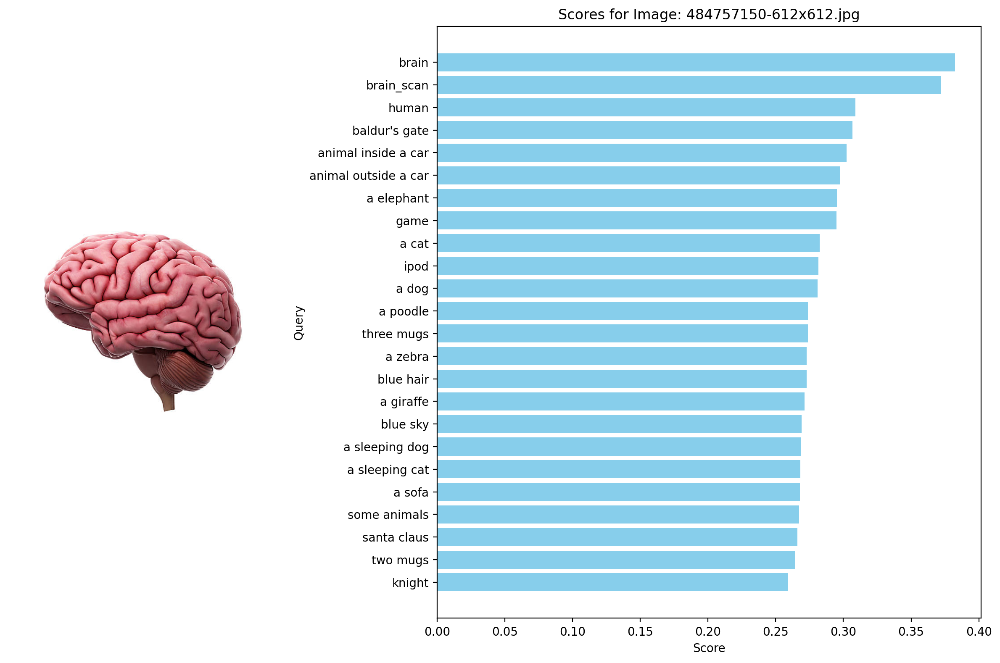

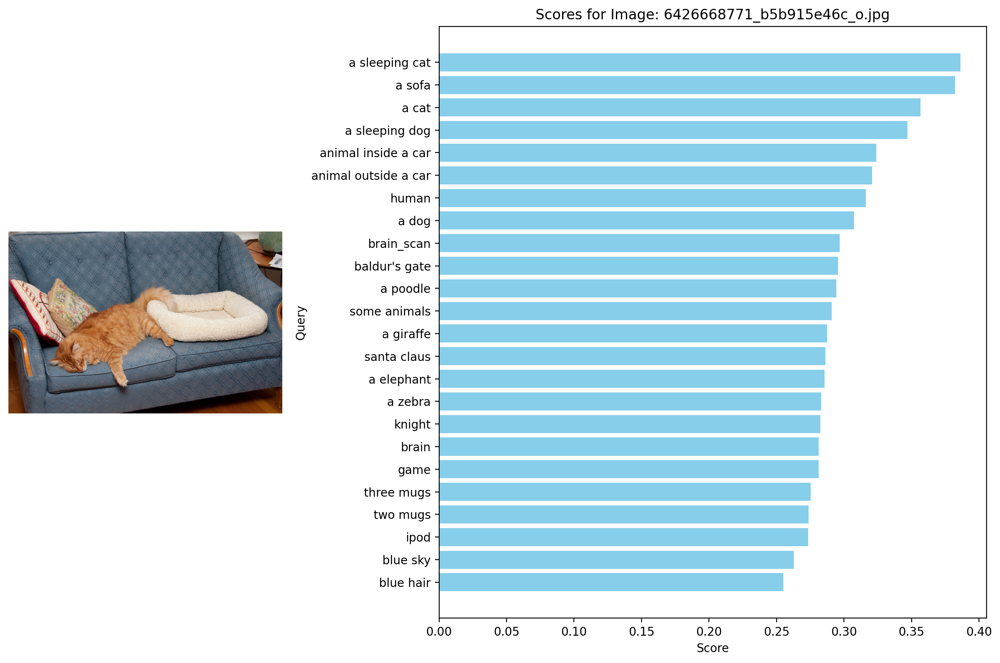

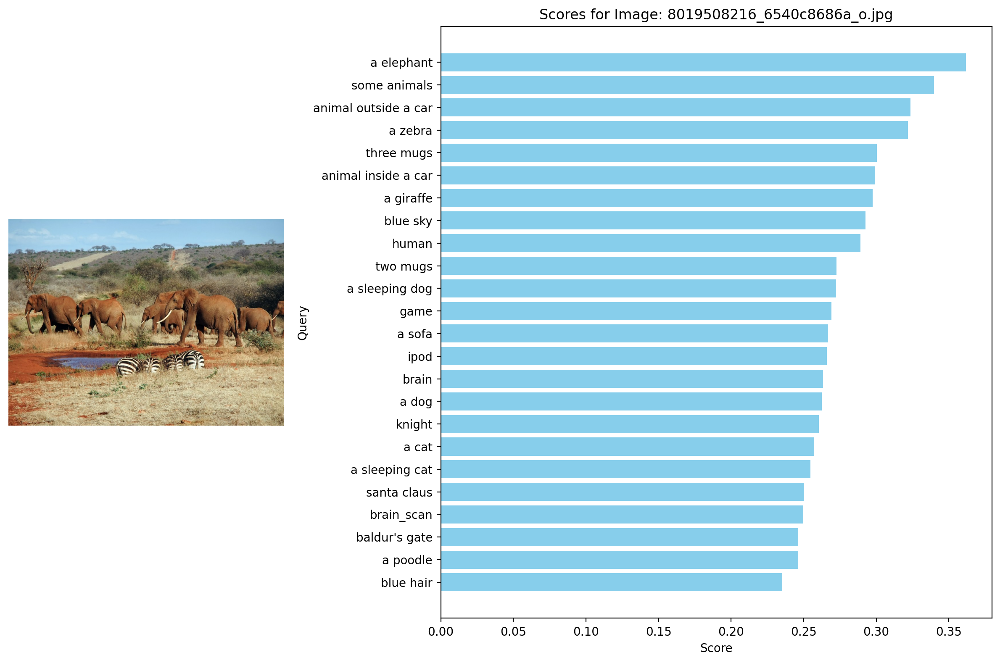

In [20]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess_resnet50_4(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model_resnet50_4.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model_resnet50_4.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()

# RN101 (ResNet-101)
- Architecture: ResNet-101
- Type: Convolutional Neural Network (CNN)
- Layers: 101 layers
- Details: ResNet-101 is similar to ResNet-50 but with more layers (101 in total). The additional layers allow the model to learn more complex features, potentially improving accuracy at the cost of increased computational complexity and memory usage.

In [21]:
model_resnet101, preprocess_resnet101 = clip.load("./openaiclipweights/clip/CLIP/models/RN101.pt")
model_resnet101.cpu().eval()

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (relu): ReLU(inplace=True)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn

C:\Users\bryan\AppData\Local\Temp\ipykernel_21352\566922023.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


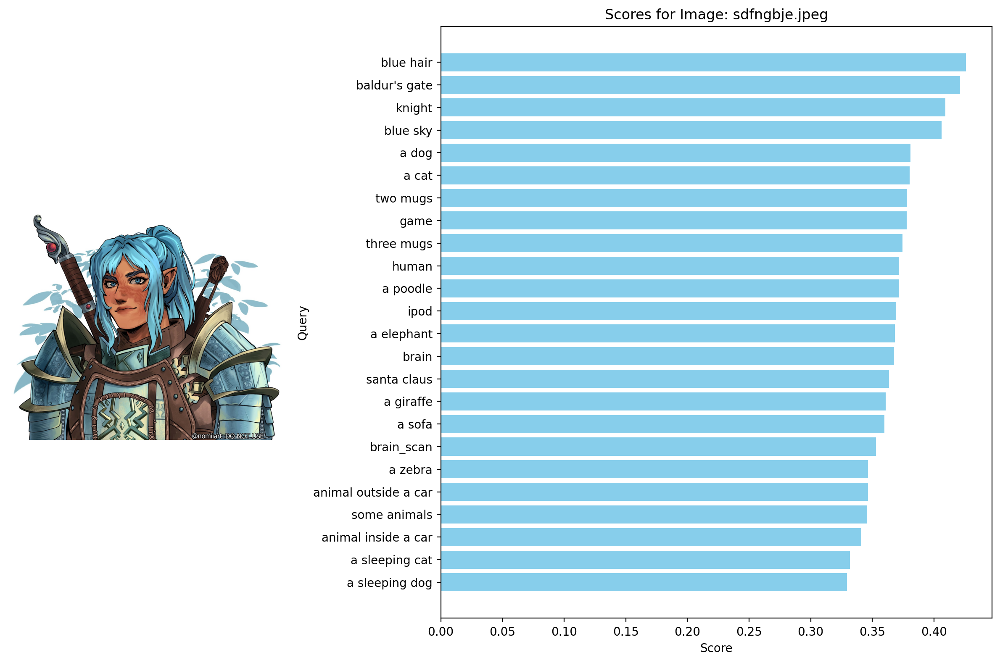

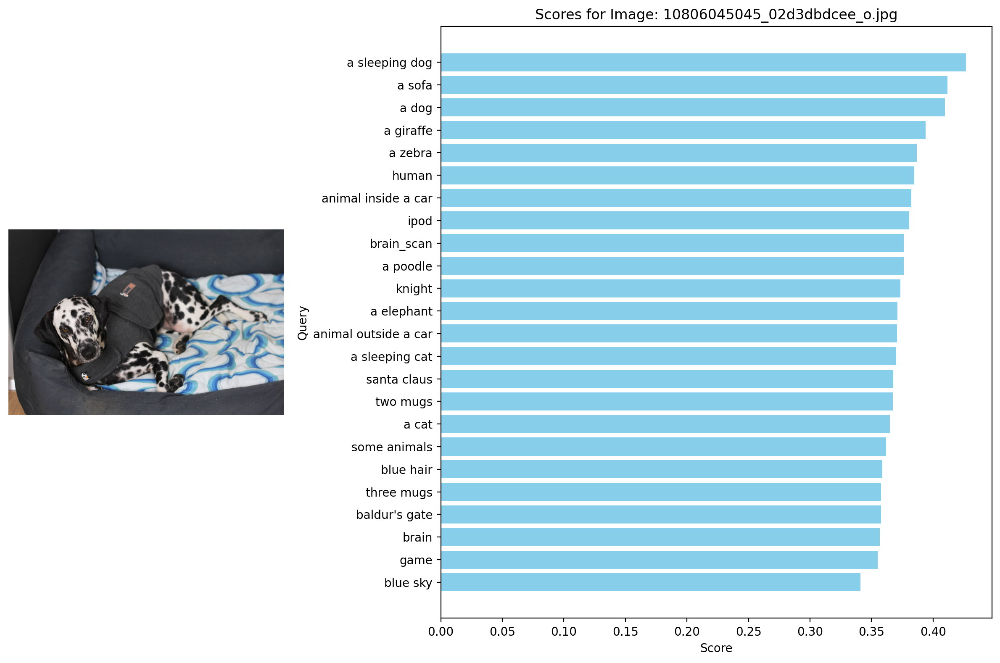

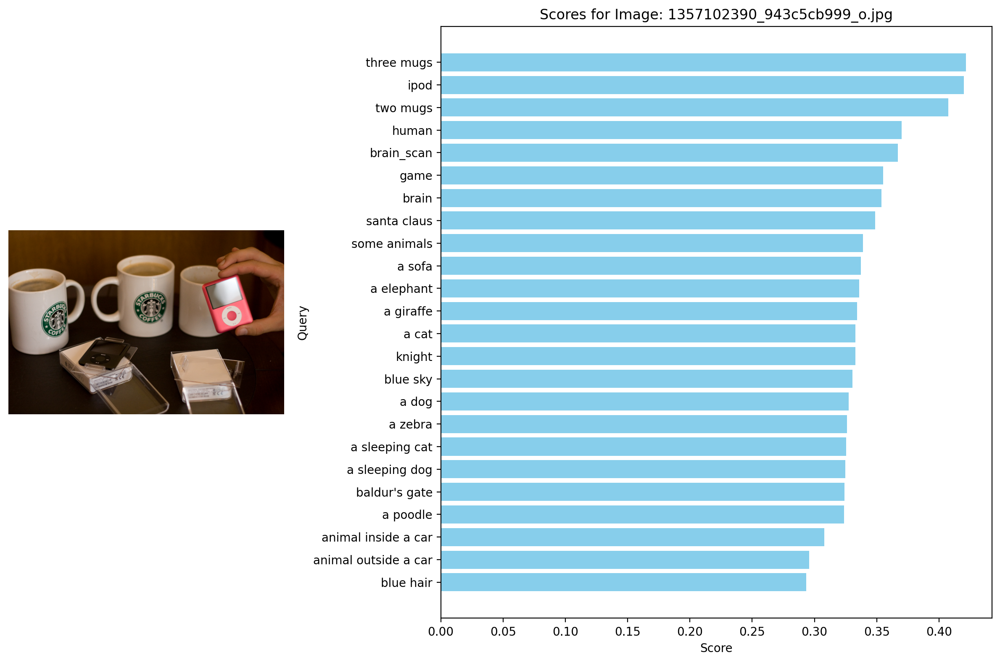

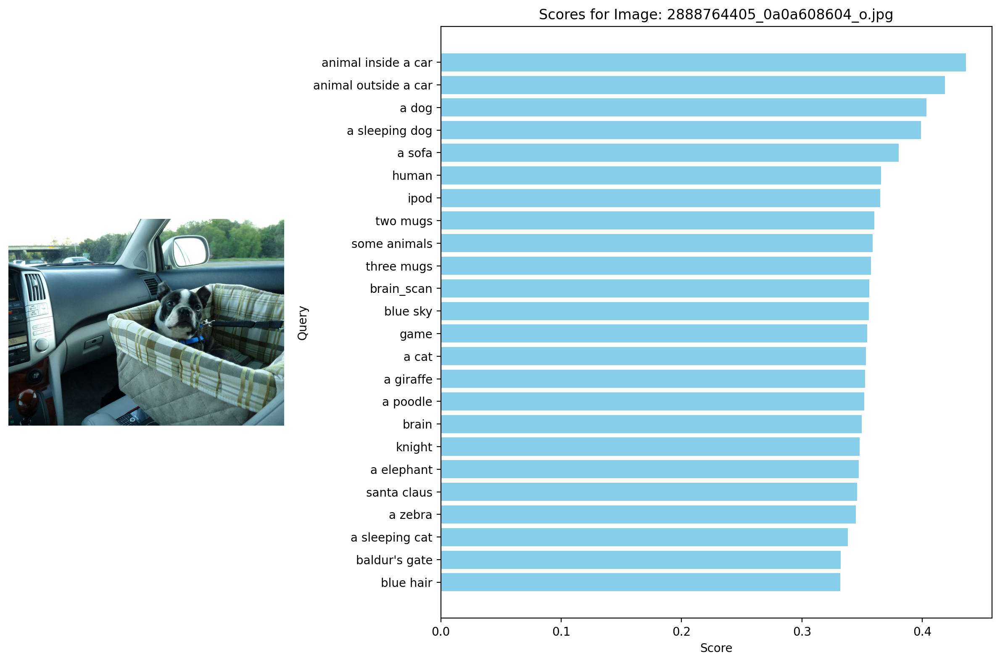

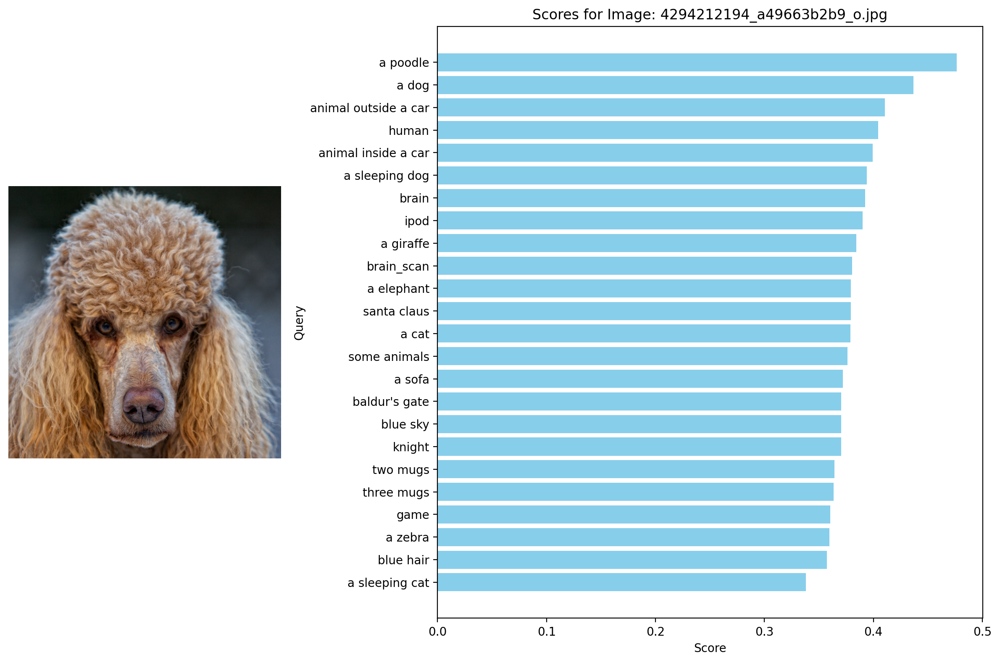

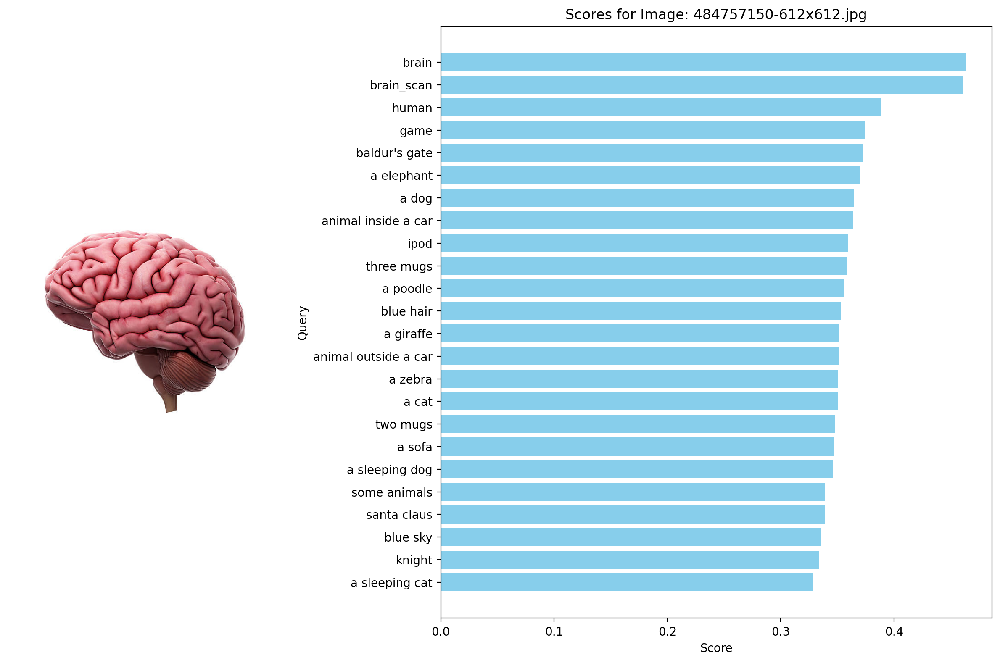

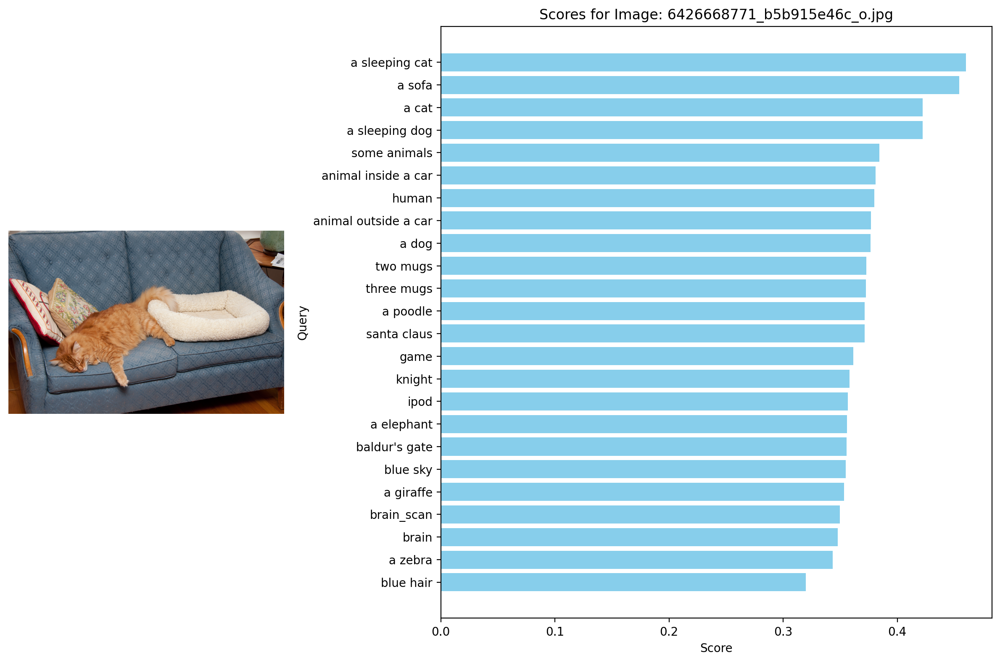

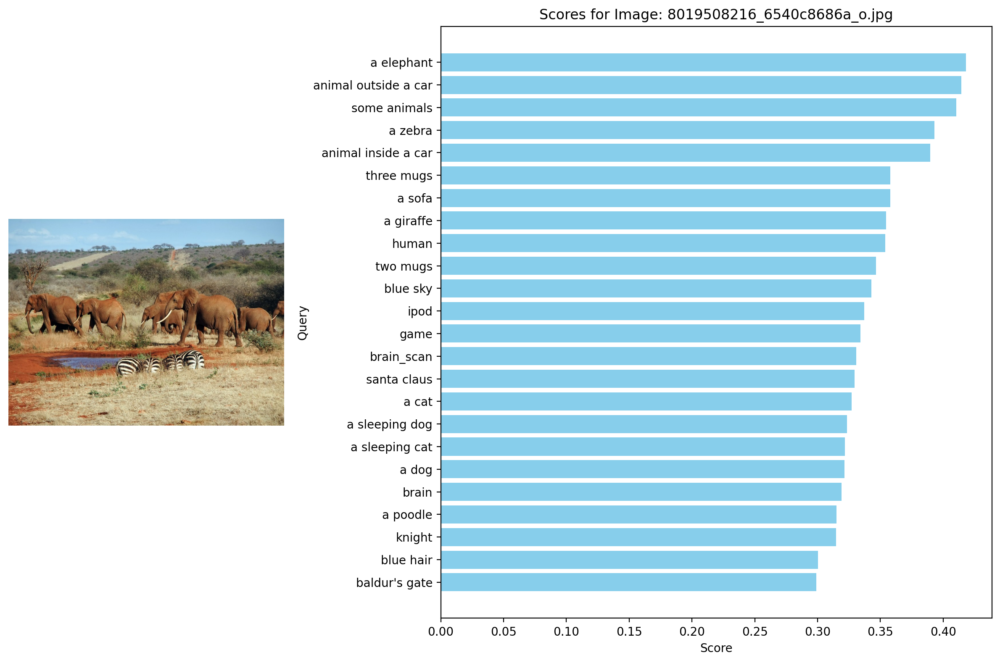

In [22]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess_resnet101(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model_resnet101.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model_resnet101.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()

# RN50 (ResNet-50)
- Architecture: ResNet-50
- Type: Convolutional Neural Network (CNN)
- Layers: 50 layers
- Details: ResNet-50 is a widely used CNN architecture that has 50 layers, including convolutional layers, pooling layers, and fully connected layers. It uses residual connections to improve gradient flow and performance on image classification tasks. This model is smaller and faster than the other variations, but may not achieve the same level of accuracy as the larger models.

In [23]:
model_resnet50, preprocess_resnet50 = clip.load("./openaiclipweights/clip/CLIP/models/RN50.pt")
model_resnet50.cpu().eval()

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (relu): ReLU(inplace=True)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn

C:\Users\bryan\AppData\Local\Temp\ipykernel_21352\4085749213.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  score = float((image_embeddings @ text_embeddings.T).numpy())


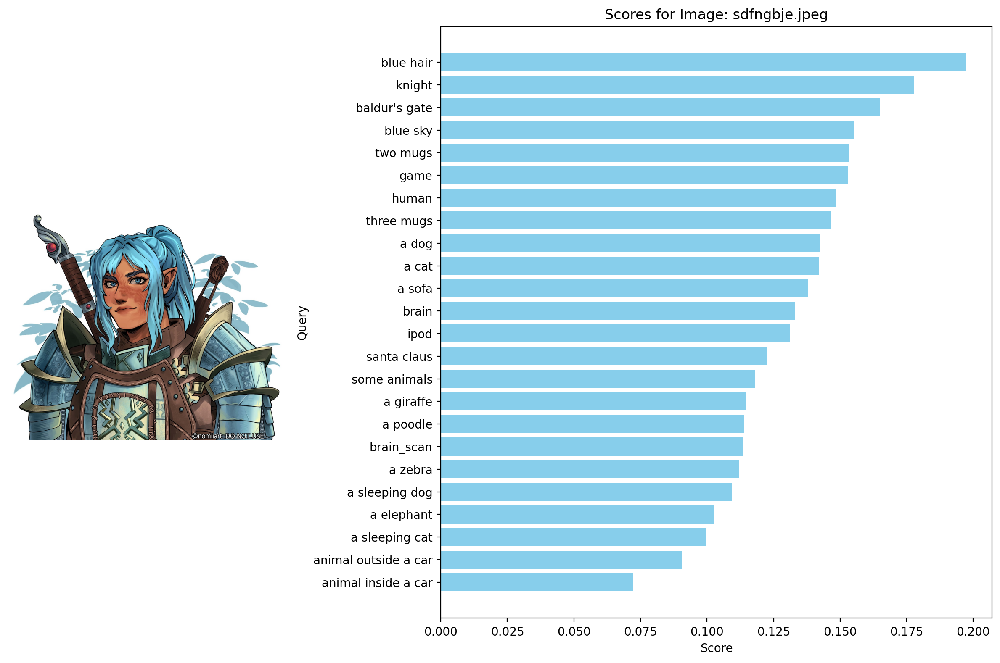

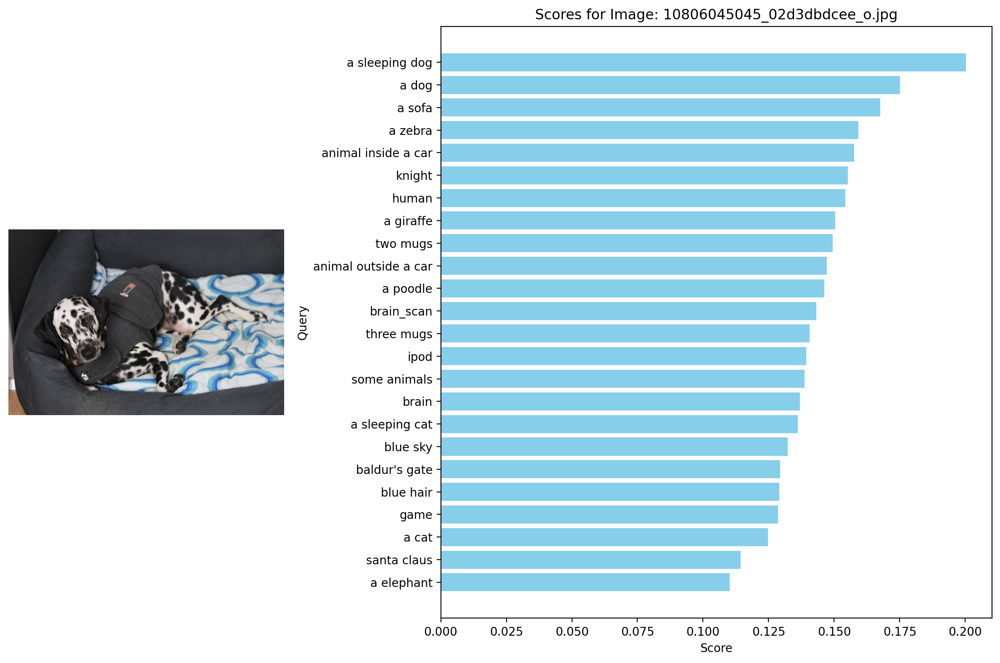

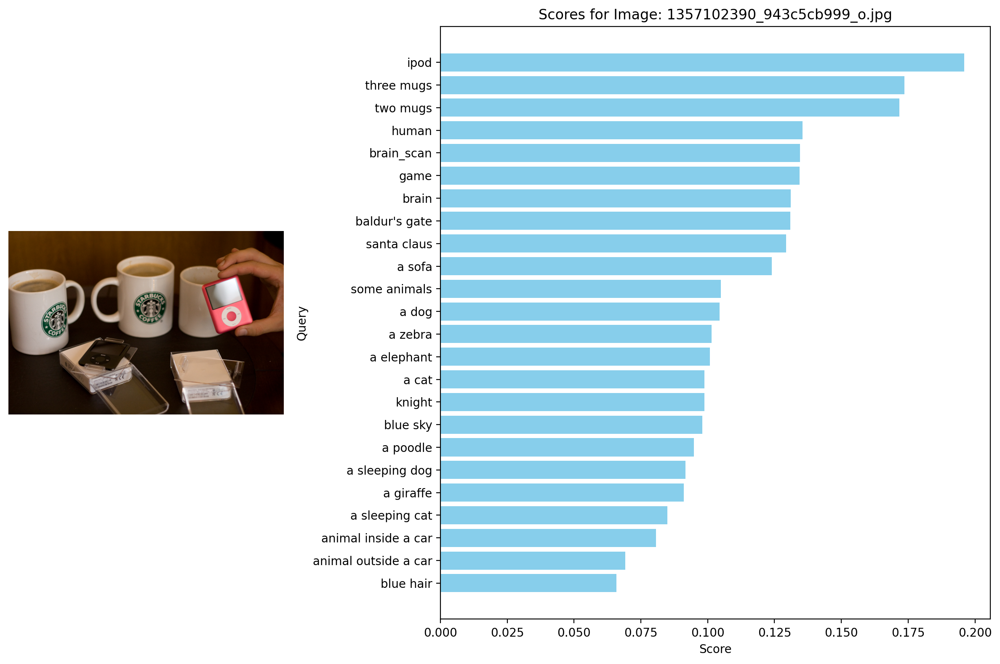

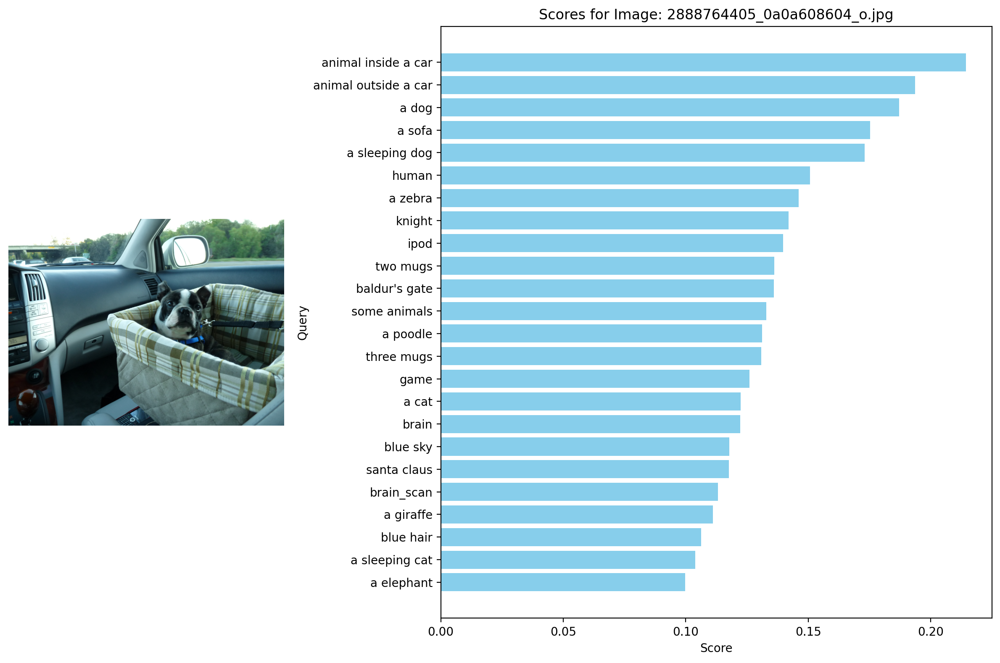

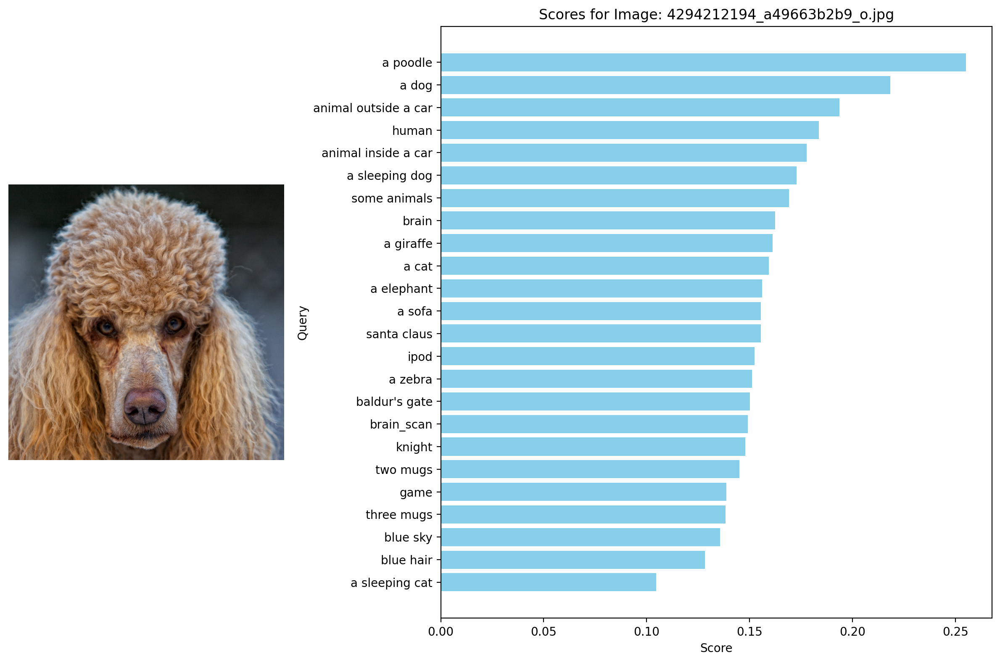

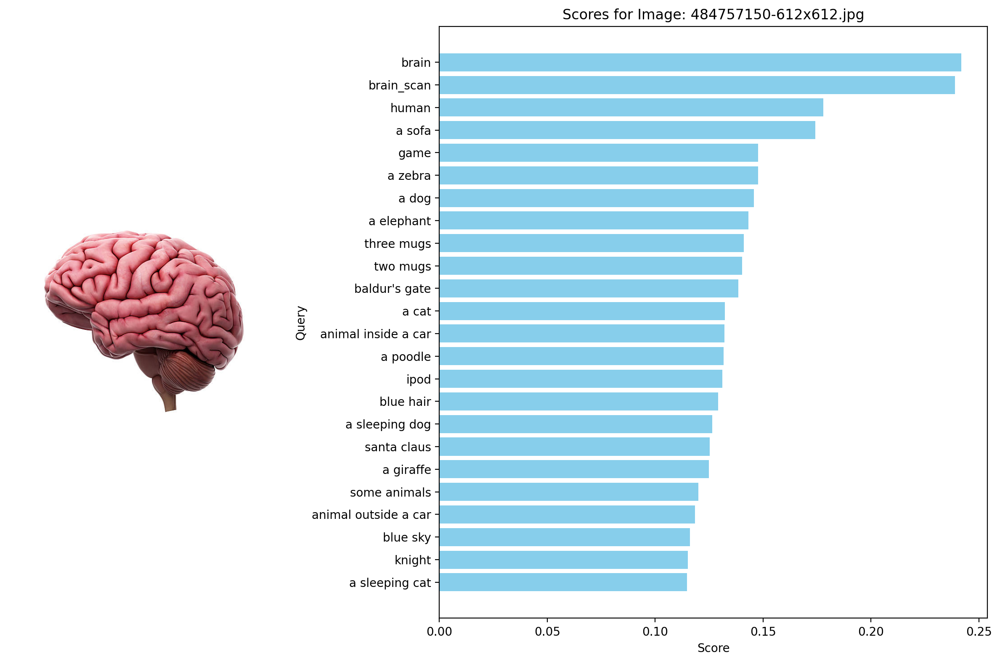

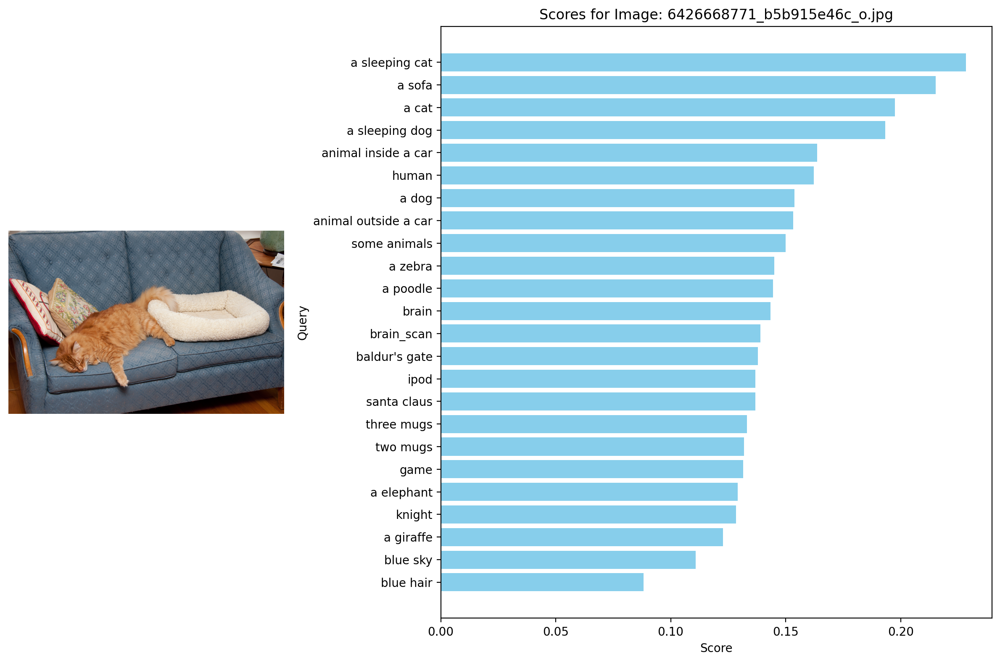

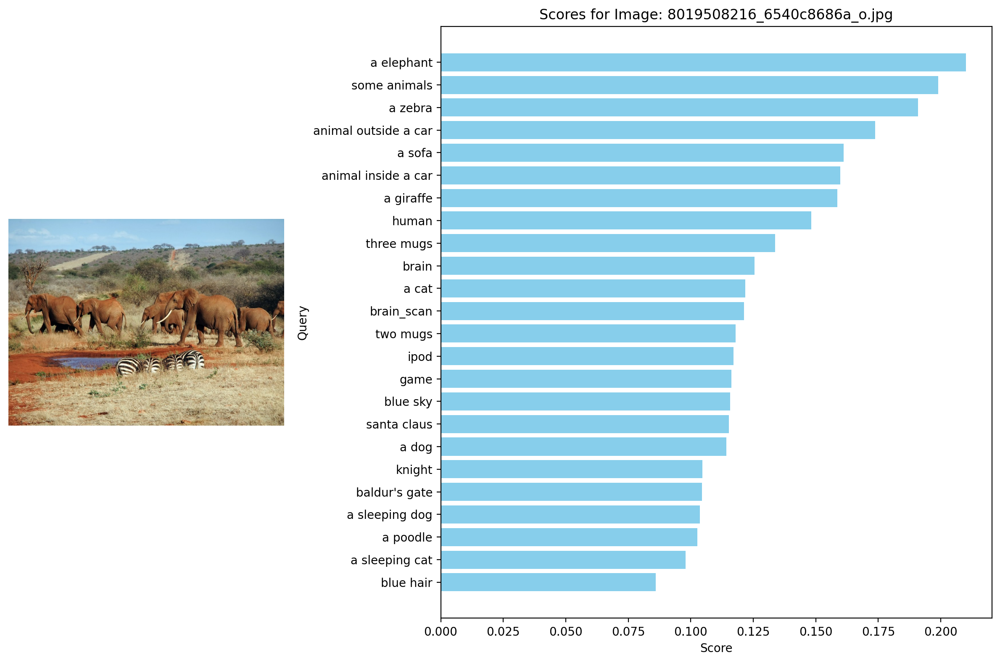

In [24]:
with torch.no_grad():
    for file in files:
        # Load image from file
        img = Image.open(file).convert("RGB")

        # Preprocess image
        img_tensor = preprocess_resnet50(img).unsqueeze(0)

        # Get Image embeddings
        image_embeddings = model_resnet50.encode_image(img_tensor)
        image_embeddings /= image_embeddings.norm(dim=-1, keepdim=True)

        # Calculate scores for each query
        scores = []
        for query in QUERIES:
            texts = clip.tokenize(query)
            
            # Get Text Embeddings
            text_embeddings = model_resnet50.encode_text(texts)
            text_embeddings /= text_embeddings.norm(dim=-1, keepdim=True)
            
            # Calculate the dot product between image and text embeddings
            score = float((image_embeddings @ text_embeddings.T).numpy())
            scores.append(score)
        
        # Convert to DataFrame
        df = pd.DataFrame({'query': QUERIES, 'score': scores}).sort_values('score', ascending=False)

        # Plotting with image on the left
        fig = plt.figure(figsize=(12, 8))
        gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])

        # Display the image
        ax0 = plt.subplot(gs[0])
        ax0.imshow(img)
        ax0.axis('off')  # Hide axis

        # Display the horizontal bar chart
        ax1 = plt.subplot(gs[1])
        ax1.barh(df['query'], df['score'], color='skyblue')
        ax1.set_xlabel('Score')
        ax1.set_ylabel('Query')
        ax1.set_title(f'Scores for Image: {file}')
        ax1.invert_yaxis()  # Invert y-axis to have the highest score on top

        plt.tight_layout()
        plt.show()